# Zafrán EDA

Análisis exploratorio de datos en Jupyter Notebook
By Alina Martinez

## Cargo librerías

In [1]:
#!conda install -c plotly plotly

In [2]:
from IPython.display import display, Markdown

import datetime, warnings

warnings.filterwarnings('ignore')

import numpy as np
import pandas as pd
import seaborn as sns

from math import sqrt

%matplotlib inline


import matplotlib.pyplot as plt
import matplotlib.gridspec as gs

import plotly
from plotly import express as px
from plotly import graph_objects as go
from plotly import figure_factory as ff
from plotly.subplots import make_subplots

from statsmodels import tsa
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.graphics.tsaplots import plot_acf
from statsmodels.tsa import stattools

import missingno as msno


In [3]:
#display(plotly.__version__)
#display(pd.__version__)

In [4]:
# Format round off to two decimal places in pandas 
pd.options.display.float_format = '{: .2f}'.format

## Cargo funciones

Desarrollo y cargo funciones a aplicar:

### Para explorar datos

In [5]:
# Definición de funciones genéricas creadas por mi

def print_columns(df):
    display(Markdown('#### List of columns:'))
    text = '| '
    for x in range(0, df.shape[1]):
        text = text + df.columns.values[x] + ' | '
    return text

def explore_var(df,var,limit=20):
    cant=df.nunique()
    df_full = df.value_counts().rename_axis('unique_values').reset_index(name='counts')
    df_full = df_full.sort_values(by=['counts'],ascending=False)
    topLimit= df_full[0:limit]
    t1='\nThere are **'+str(cant)+'** different value in the **'+str(var)+'** variable of the dataframe.'
    if cant<=1:
        t1='\nThere is **only one** different value in the **'+str(var)+'** variable of the dataframe.'
        t2 ='The value is:'  
    elif cant>=limit:
        t2='The list of the first **'+str(limit)+'**  values:'
        df_full = topLimit
    else:
        t2 ='The list of the **'+str(cant)+'**  values:'    
    display(Markdown(t1))
    display(Markdown(t2))
    return df_full

def print_last(df):
    display(df.tail(1))
    
def missing_zero_values_table(df):
    zero_val=df.isin([0]).sum(axis=0)
    mis_val=df.isnull().sum()
    l=len(df)
    mis_val_percent=100*df.isnull().sum()/l
    zero_val_percent=100*df.isin([0]).sum()/l
    mz_table=pd.concat([zero_val,zero_val_percent,mis_val,mis_val_percent],axis=1)
    mz_table=mz_table.rename(
        columns={
            0:'Zero Values', 
            1:'% of Zero Values', 
            2:'Missing Values', 
            3:'% of Missing Values'}
    )
    mz_table['Total Missing Values']=mz_table['Zero Values']+mz_table['Missing Values']
    mz_table['% Total Missing Values']=100*mz_table['Total Missing Values']/l
    mz_table=mz_table[mz_table.iloc[:,4] != 0].sort_values(
    '% Total Missing Values', ascending=False).round(1)
    tc=str(df.shape[1])
    tr=str(df.shape[0])
    tcm=str(mz_table.shape[0])
    txt='Your selected dataframe has '+str(tc)+' columns and '+str(tr)+' Rows.'
    txt+='\nThere are '+str(tcm)+' columns that have missing values.'
    display(mz_table)
    return txt

def IQR_outliers(df, col, width=1.5):
    Q1 = np.nanpercentile(df[col],25)
    Q3 = np.nanpercentile(df[col],75)
    IQR = Q3 - Q1
    df = df[~(
        (df[col] < (Q1 - width * IQR)) | (df[col] > (Q3 + width * IQR))
         )]
    return df


In [6]:
# Aplicación de IQR con visualización de resultados

def apply_IQR(df,cols,chart=False):
    df_15 = df.copy()
    df_3 = df.copy()
    for col in cols:
        df_15 = IQR_outliers(df_15, col)
        df_3 = IQR_outliers(df_3, col, 3)
        if chart:
            # Grafico resultado
            fig = go.Figure()
            fig.add_trace(go.Box(
                y=df_15[col],
                name='Only Mean (IQR 1.5)',
                marker_color='darkblue',
                boxmean=True
            ))
            fig.add_trace(go.Box(
                y=df_15[col],
                name='Mean & SD (IQR 1.5)',
                marker_color='royalblue',
                boxmean='sd'
            ))
            fig.add_trace(go.Box(
                y=df_3[col],
                name='Only Mean (IQR 3)',
                marker_color='darkblue',
                boxmean=True
            ))
            fig.add_trace(go.Box(
                y=df_3[col],
                name='Mean & SD (IQR 3)',
                marker_color='royalblue',
                boxmean='sd'
            ))
            fig.update_layout(title='New Outliers of the '+col+' variable')
            fig.show()
    return df_15,df_3

### Para graficar

In [7]:
# Definición de funciones para graficar con Plotly creadas por mi

In [8]:
def graf_histograms_1(df):    
    check_num_col = df.dtypes == 'float64'
    num_cols = sorted(check_num_col[check_num_col].index)
    dfplot = df[num_cols]
    for col in num_cols:
        title_text="Histogram of Numerical Variable "+str(num_cols)
        fig = px.histogram(dfplot[col], x=dfplot[col])
        fig.update_layout(height=300, width=300, title_text=title_text)
        fig.show()    

def graf_histograms_2(df,max_cols=3):  
    check_num_col = df.dtypes == 'float64'
    num_cols = sorted(check_num_col[check_num_col].index)
    cant_num_cols = len(num_cols) 
    dfplot = df[num_cols]
    max_rows=int(round(cant_num_cols/max_cols,0))
    c=1
    r=1
    fig = make_subplots(rows=max_rows, cols=max_cols, subplot_titles=(num_cols))
    for col in num_cols:
        fig.append_trace(go.Histogram(x=dfplot[col], nbinsx=50), r,c)
        r+=1
        if r > max_rows:
            r=1
            c+=1
        if c > max_cols:
            c=1 
            r=1
    fig.update_layout(height=600, width=950, title_text="Histogram of Numerical Variables")
    fig.show() 

In [9]:

def graf_map(df,color='',size='',title=''):
    fig = px.scatter_mapbox(
        df, 
        lat="lat", 
        lon="lon", 
        color=color,
        size=size,
        color_continuous_scale=px.colors.cyclical.IceFire,
        center=dict(lat=-34.615,lon=-58.44),
        zoom=11,
        width = 900,
        height = 800,
        title = title,
        mapbox_style="carto-positron"
        )
    fig.show()

def graf_outlier(df,cols): 
    for col in cols:
        fig = go.Figure()
        fig.add_trace(go.Box(
            y=df[col],
            name='Only Mean',
            marker_color='darkblue',
            boxmean=True # represent mean
        ))
        fig.add_trace(go.Box(
            y=df[col],
            name='Mean & SD',
            marker_color='royalblue',
            boxmean='sd' # represent mean and standard deviation
        ))
        fig.update_layout(
            title='Outliers of the '+col+' variable',
            width = 900,
            height = 500,
        )
        fig.show()

def graf_corr(df,chart=True):
    corr = df.corr()
    if chart:
        fig = ff.create_annotated_heatmap(
            z=corr.values,
            x=list(corr.columns),
            y=list(corr.index),
            annotation_text=corr.round(2).values,
            showscale=True
        )
        fig.update_layout(
            title='Correlation between variables',
            dragmode='select',
            height=750,
            hovermode='closest',
        )
        fig.show()
    display(Markdown('#### Correlation Table'))
    display(corr)
    return corr

def graf_table(df,title='',height='',height_constant=20):
    fig = ff.create_table(df, height_constant=height_constant)
    fig.layout.margin.update({'t':75, 'l':50})
    fig.layout.update({'title': title})
    fig.layout.update({'height':height})
    fig.show()
    
    
def quick_view(df,desc=True,rows=True,cols=True,corr=2,zeros=True):
    print()
    if rows: 
        display(Markdown('### **Some rows** of the dataframe'))
        display(df)
        print()
    if cols:
        display(Markdown('### **Columns** of the dataframe'))
        print(print_columns(df))
        print()
    if desc:
        display(Markdown('### Dataframe **describe**'))
        display(df.describe(include='all'))
        print()
    if corr==1:
        display(Markdown('### Dataframe **correlation**'))
        graf_corr(df,False)
        print()
    elif corr==2:
        display(Markdown('### Dataframe **correlation**'))
        graf_corr(df,True)
        print()          
    if zeros:
        display(Markdown('### Dataframe **missing values**'))
        print(missing_zero_values_table(df))
        print()
        

### Settings 

#### input/output datasets

In [10]:
# Dirección absoluta para respaldos

#file_dir = os.getcwd() + '/'
#display(file_dir)

# Dirección relativa para datasets de inputs
input_folder = 'datasets/made/'

# Dirección relativa para datasets de outputs
output_folder = 'datasets/outputs/'

# Ventas (r00_ventas)

In [11]:
r00_ventas = pd.read_csv(input_folder + 'r00_ventas.csv')
r00_ventas

,invoice_line_id,invoice_line_origin,price_unit,price_subtotal,currency_id,partner_id,account_id,discount,price_subtotal_signed,invoice_line_name,...,product_uom_factor,product_brand,product_pack_cat_name,product_pack_cat_qty,product_category,product_flavor,order_line_id,salesman_id,periodo,date_periodo
0,109,SO0000009,1562.18,1562.18,20,4671,166,0.00,1562.18,[BAR001x8x12] BARRA | Almendras y coco 8 disp ...,...,0.01,zafrán,BARx96,96,BAR,Combo Online,nan,nan,201807,2018-07-01
1,110,SO0000009,1562.18,781.09,20,4671,166,0.00,781.09,[BAR002x8x12] BARRA | Maní y cacao 8 disp 12u ...,...,0.01,zafrán,BARx96,96,BAR,Maní y cacao,nan,nan,201807,2018-07-01
2,111,SO0000009,1562.18,781.09,20,4671,166,0.00,781.09,[BAR003x8x12] BARRA | Manzana y chía 8 disp 12...,...,0.01,zafrán,BARx96,96,BAR,Manzana y chía,nan,nan,201807,2018-07-01
3,112,SO0000009,1562.18,781.09,20,4671,166,0.00,781.09,[BAR004x8x12] BARRA | Cajú y semillas de zapal...,...,0.01,zafrán,BARx96,96,BAR,Cajú y semillas de zapallo,nan,nan,201807,2018-07-01
4,113,SO0000013,312.80,312.80,20,2626,168,0.00,312.80,"[GAL001x20] GALLETITA | Avena, pasas y chía 20...",...,0.05,zafrán,GALx20,20,GAL,"Avena, pasas y chía",nan,nan,201807,2018-07-01
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
50157,85482,WOO64565,663.64,663.64,20,84467,166,0.00,663.64,[BAR002x12] BARRA | Maní y cacao disp 12u x28g,...,0.01,zafrán,BARx96,96,BAR,Maní y cacao,309277.00,1.00,0,NaN
50158,85484,WOO64566,2654.54,2654.54,20,84469,166,0.00,2654.54,[BAR001x60] BARRA | Almendras y coco 60u x28g,...,0.02,zafrán,BARx60,60,BAR,Combo Online,309279.00,1.00,0,NaN
50159,85486,WOO64567,2654.54,2654.54,20,84471,166,0.00,2654.54,[BAR002x60] BARRA | Maní y cacao 60u x28g,...,0.02,zafrán,BARx60,60,BAR,Maní y cacao,309281.00,1.00,0,NaN
50160,85488,WOO64568,2654.54,2654.54,20,74241,166,0.00,2654.54,[BAR006x60] BARRA | Arándanos y almendras 60u ...,...,0.02,zafrán,BARx60,60,BAR,Arándanos y almendras,309283.00,1.00,0,NaN


## EDA

In [12]:
df = r00_ventas.copy()

### Tipos de Variables
Con estas funciones rápidamente podemos observar de qué tipo son las variables:

In [13]:
df.info()
#df.dtypes

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 50162 entries, 0 to 50161
Data columns (total 41 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   invoice_line_id          50162 non-null  int64  
 1   invoice_line_origin      49932 non-null  object 
 2   price_unit               50162 non-null  float64
 3   price_subtotal           50162 non-null  float64
 4   currency_id              50162 non-null  int64  
 5   partner_id               50162 non-null  int64  
 6   account_id               50162 non-null  int64  
 7   discount                 50162 non-null  float64
 8   price_subtotal_signed    50162 non-null  float64
 9   invoice_line_name        50162 non-null  object 
 10  product_id               50162 non-null  int64  
 11  invoice_id               50162 non-null  int64  
 12  quantity                 50162 non-null  float64
 13  account_id_account       50162 non-null  int64  
 14  account_code          

In [14]:
# Transformar X columna a formato datetime
df['date'] = pd.to_datetime(df['date_periodo'])
df

,invoice_line_id,invoice_line_origin,price_unit,price_subtotal,currency_id,partner_id,account_id,discount,price_subtotal_signed,invoice_line_name,...,product_brand,product_pack_cat_name,product_pack_cat_qty,product_category,product_flavor,order_line_id,salesman_id,periodo,date_periodo,date
0,109,SO0000009,1562.18,1562.18,20,4671,166,0.00,1562.18,[BAR001x8x12] BARRA | Almendras y coco 8 disp ...,...,zafrán,BARx96,96,BAR,Combo Online,nan,nan,201807,2018-07-01,2018-07-01
1,110,SO0000009,1562.18,781.09,20,4671,166,0.00,781.09,[BAR002x8x12] BARRA | Maní y cacao 8 disp 12u ...,...,zafrán,BARx96,96,BAR,Maní y cacao,nan,nan,201807,2018-07-01,2018-07-01
2,111,SO0000009,1562.18,781.09,20,4671,166,0.00,781.09,[BAR003x8x12] BARRA | Manzana y chía 8 disp 12...,...,zafrán,BARx96,96,BAR,Manzana y chía,nan,nan,201807,2018-07-01,2018-07-01
3,112,SO0000009,1562.18,781.09,20,4671,166,0.00,781.09,[BAR004x8x12] BARRA | Cajú y semillas de zapal...,...,zafrán,BARx96,96,BAR,Cajú y semillas de zapallo,nan,nan,201807,2018-07-01,2018-07-01
4,113,SO0000013,312.80,312.80,20,2626,168,0.00,312.80,"[GAL001x20] GALLETITA | Avena, pasas y chía 20...",...,zafrán,GALx20,20,GAL,"Avena, pasas y chía",nan,nan,201807,2018-07-01,2018-07-01
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
50157,85482,WOO64565,663.64,663.64,20,84467,166,0.00,663.64,[BAR002x12] BARRA | Maní y cacao disp 12u x28g,...,zafrán,BARx96,96,BAR,Maní y cacao,309277.00,1.00,0,NaN,NaT
50158,85484,WOO64566,2654.54,2654.54,20,84469,166,0.00,2654.54,[BAR001x60] BARRA | Almendras y coco 60u x28g,...,zafrán,BARx60,60,BAR,Combo Online,309279.00,1.00,0,NaN,NaT
50159,85486,WOO64567,2654.54,2654.54,20,84471,166,0.00,2654.54,[BAR002x60] BARRA | Maní y cacao 60u x28g,...,zafrán,BARx60,60,BAR,Maní y cacao,309281.00,1.00,0,NaN,NaT
50160,85488,WOO64568,2654.54,2654.54,20,74241,166,0.00,2654.54,[BAR006x60] BARRA | Arándanos y almendras 60u ...,...,zafrán,BARx60,60,BAR,Arándanos y almendras,309283.00,1.00,0,NaN,NaT


In [15]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 50162 entries, 0 to 50161
Data columns (total 42 columns):
 #   Column                   Non-Null Count  Dtype         
---  ------                   --------------  -----         
 0   invoice_line_id          50162 non-null  int64         
 1   invoice_line_origin      49932 non-null  object        
 2   price_unit               50162 non-null  float64       
 3   price_subtotal           50162 non-null  float64       
 4   currency_id              50162 non-null  int64         
 5   partner_id               50162 non-null  int64         
 6   account_id               50162 non-null  int64         
 7   discount                 50162 non-null  float64       
 8   price_subtotal_signed    50162 non-null  float64       
 9   invoice_line_name        50162 non-null  object        
 10  product_id               50162 non-null  int64         
 11  invoice_id               50162 non-null  int64         
 12  quantity                 50162 n

### Estadísticos
Veamos los estadísticos del dataset:

In [16]:
df.describe()

,invoice_line_id,price_unit,price_subtotal,currency_id,partner_id,account_id,discount,price_subtotal_signed,product_id,invoice_id,...,account_id_account,partner_country_id,partner_state_id,product_weight,product_volume,product_uom_factor,product_pack_cat_qty,order_line_id,salesman_id,periodo
count,50162.00,50162.00,50162.00,50162.00,50162.00,50162.00,50162.00,50162.00,50162.00,50162.00,...,50162.00,45899.00,45605.00,50130.00,50130.00,50162.00,50162.00,47781.00,47781.00,50162.00
mean,41347.77,918.39,4324.12,20.00,16453.33,179.51,3.06,3855.90,821.50,9117.17,...,179.51,11.00,555.04,1.87,7.67,0.22,54.67,129375.76,5.38,201282.38
std,25510.24,857.18,19110.23,0.00,26842.80,77.49,10.10,19210.18,1153.88,5526.65,...,77.49,0.11,9.76,1.62,6.12,0.39,32.75,114409.52,2.60,11633.66
min,109.00,0.00,-1598.87,20.00,2601.00,166.00,0.00,-1770240.00,208.00,74.00,...,166.00,6.00,433.00,0.02,0.09,0.01,7.00,3620.00,1.00,0.00
25%,19389.25,312.80,403.80,20.00,2763.00,166.00,0.00,360.33,223.00,4249.00,...,166.00,11.00,552.00,0.34,1.44,0.01,20.00,33836.00,1.00,201904.00
50%,37380.50,601.20,1230.60,20.00,4902.00,167.00,0.00,1159.92,248.00,8298.00,...,167.00,11.00,553.00,1.68,6.00,0.02,60.00,70590.00,7.00,201912.00
75%,66283.75,1421.97,3006.00,20.00,9538.00,168.00,3.00,2908.22,271.00,14431.00,...,168.00,11.00,553.00,2.69,12.30,0.05,96.00,267252.00,7.00,202008.00
max,85489.00,4918.08,1770240.00,20.00,84471.00,666.00,100.00,1770240.00,3467.00,18728.00,...,666.00,11.00,647.00,7.00,20.00,1.00,96.00,309284.00,9.00,202104.00


In [17]:
pd.set_option('display.max_columns', None)

### Examino el tamaño

In [18]:
print('El dataframe tiene',df.shape[0],'filas y',df.shape[1],'columnas.')

El dataframe tiene 50162 filas y 42 columnas.


### Nulos y VA
Analizamos nulos y valores faltantes:

In [19]:
missing_zero_values_table(df)

,Zero Values,% of Zero Values,Missing Values,% of Missing Values,Total Missing Values,% Total Missing Values
discount,35432,70.60,0,0.00,35432,70.60
partner_zip,0,0.00,20930,41.70,20930,41.70
partner_market_category,0,0.00,10753,21.40,10753,21.40
partner_city,0,0.00,8730,17.40,8730,17.40
partner_state_id,0,0.00,4557,9.10,4557,9.10
price_subtotal,4551,9.10,0,0.00,4551,9.10
price_subtotal_signed,4551,9.10,0,0.00,4551,9.10
partner_country_id,0,0.00,4263,8.50,4263,8.50
price_unit,4129,8.20,0,0.00,4129,8.20
salesman_id,0,0.00,2381,4.70,2381,4.70


'Your selected dataframe has 42 columns and 50162 Rows.\nThere are 19 columns that have missing values.'

### Duplicated

In [20]:
duplicates = df[df.duplicated()]
print('La cantidad de elementos duplicados es:', duplicates.shape[0])

La cantidad de elementos duplicados es: 0


In [21]:
# Elimino duplicados

df_drop_duplicates=df.drop_duplicates()
df_drop_duplicates.shape

print('La cantidad de elementos sin duplicados es:', df_drop_duplicates.shape[0])

La cantidad de elementos sin duplicados es: 50162


### Imprimo las columnas del dataframe

In [22]:
print(print_columns(df))

#### List of columns:

| invoice_line_id | invoice_line_origin | price_unit | price_subtotal | currency_id | partner_id | account_id | discount | price_subtotal_signed | invoice_line_name | product_id | invoice_id | quantity | account_id_account | account_code | account_name | invoice_date_invoice | invoice_state | partner_name | partner_city | partner_zip | partner_country_id | partner_state_id | customer | partner_market_category | product_weight | product_default_code | product_barcode | product_volume | product_sale_ok | product_uom | product_uom_factor | product_brand | product_pack_cat_name | product_pack_cat_qty | product_category | product_flavor | order_line_id | salesman_id | periodo | date_periodo | date | 


### Examino la relación jerárquica de las variables

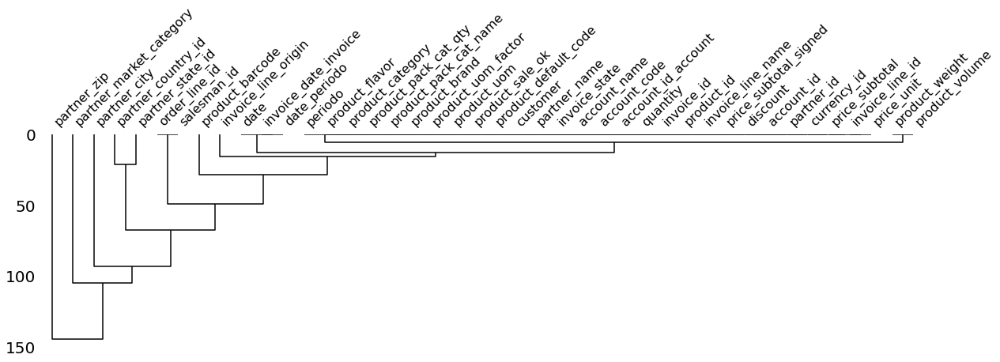

In [23]:
msno.dendrogram(df, figsize=(20, 5))

### Corr

In [24]:
graf_corr(df)

#### Correlation Table

,invoice_line_id,price_unit,price_subtotal,currency_id,partner_id,account_id,discount,price_subtotal_signed,product_id,invoice_id,quantity,account_id_account,partner_country_id,partner_state_id,product_weight,product_volume,product_uom_factor,product_pack_cat_qty,order_line_id,salesman_id,periodo
invoice_line_id,1.00,0.30,0.09,nan,0.53,0.19,-0.02,0.09,0.20,1.00,0.02,0.19,0.00,0.01,-0.02,-0.01,0.03,-0.07,0.96,-0.18,-0.09
price_unit,0.30,1.00,0.15,nan,-0.04,-0.03,0.06,0.14,-0.06,0.30,-0.09,-0.03,-0.04,0.03,0.51,0.49,-0.48,0.33,0.28,0.31,-0.03
price_subtotal,0.09,0.15,1.00,nan,-0.06,-0.02,-0.00,0.61,0.05,0.09,0.47,-0.02,0.00,-0.03,0.11,0.10,-0.11,-0.00,0.09,0.12,0.01
currency_id,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
partner_id,0.53,-0.04,-0.06,nan,1.00,0.16,-0.08,-0.05,0.08,0.53,-0.05,0.16,0.01,0.00,-0.23,-0.26,0.21,-0.03,0.58,-0.53,-0.00
account_id,0.19,-0.03,-0.02,nan,0.16,1.00,-0.01,-0.01,0.35,0.19,-0.02,1.00,0.00,0.02,-0.08,-0.11,0.14,-0.24,0.21,-0.04,0.00
discount,-0.02,0.06,-0.00,nan,-0.08,-0.01,1.00,-0.01,-0.01,-0.02,-0.02,-0.01,-0.02,0.06,0.12,0.13,-0.02,-0.02,-0.01,0.14,0.02
price_subtotal_signed,0.09,0.14,0.61,nan,-0.05,-0.01,-0.01,1.00,0.05,0.09,0.24,-0.01,0.00,-0.03,0.09,0.10,-0.09,-0.00,0.09,0.12,0.00
product_id,0.20,-0.06,0.05,nan,0.08,0.35,-0.01,0.05,1.00,0.19,0.01,0.35,0.00,-0.02,-0.07,-0.03,-0.05,-0.14,0.20,0.10,-0.04
invoice_id,1.00,0.30,0.09,nan,0.53,0.19,-0.02,0.09,0.19,1.00,0.02,0.19,0.00,0.01,-0.02,-0.01,0.03,-0.07,0.96,-0.18,-0.09


,invoice_line_id,price_unit,price_subtotal,currency_id,partner_id,account_id,discount,price_subtotal_signed,product_id,invoice_id,quantity,account_id_account,partner_country_id,partner_state_id,product_weight,product_volume,product_uom_factor,product_pack_cat_qty,order_line_id,salesman_id,periodo
invoice_line_id,1.00,0.30,0.09,nan,0.53,0.19,-0.02,0.09,0.20,1.00,0.02,0.19,0.00,0.01,-0.02,-0.01,0.03,-0.07,0.96,-0.18,-0.09
price_unit,0.30,1.00,0.15,nan,-0.04,-0.03,0.06,0.14,-0.06,0.30,-0.09,-0.03,-0.04,0.03,0.51,0.49,-0.48,0.33,0.28,0.31,-0.03
price_subtotal,0.09,0.15,1.00,nan,-0.06,-0.02,-0.00,0.61,0.05,0.09,0.47,-0.02,0.00,-0.03,0.11,0.10,-0.11,-0.00,0.09,0.12,0.01
currency_id,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
partner_id,0.53,-0.04,-0.06,nan,1.00,0.16,-0.08,-0.05,0.08,0.53,-0.05,0.16,0.01,0.00,-0.23,-0.26,0.21,-0.03,0.58,-0.53,-0.00
account_id,0.19,-0.03,-0.02,nan,0.16,1.00,-0.01,-0.01,0.35,0.19,-0.02,1.00,0.00,0.02,-0.08,-0.11,0.14,-0.24,0.21,-0.04,0.00
discount,-0.02,0.06,-0.00,nan,-0.08,-0.01,1.00,-0.01,-0.01,-0.02,-0.02,-0.01,-0.02,0.06,0.12,0.13,-0.02,-0.02,-0.01,0.14,0.02
price_subtotal_signed,0.09,0.14,0.61,nan,-0.05,-0.01,-0.01,1.00,0.05,0.09,0.24,-0.01,0.00,-0.03,0.09,0.10,-0.09,-0.00,0.09,0.12,0.00
product_id,0.20,-0.06,0.05,nan,0.08,0.35,-0.01,0.05,1.00,0.19,0.01,0.35,0.00,-0.02,-0.07,-0.03,-0.05,-0.14,0.20,0.10,-0.04
invoice_id,1.00,0.30,0.09,nan,0.53,0.19,-0.02,0.09,0.19,1.00,0.02,0.19,0.00,0.01,-0.02,-0.01,0.03,-0.07,0.96,-0.18,-0.09


In [25]:
df_filtered = df.loc[:,
    [
        'price_subtotal_signed',
        'price_subtotal',
        'product_id',
        'price_unit',
        'quantity',
        'discount',
        'invoice_state',
        'periodo',
        'partner_id'
    ]
]
df_filtered

,price_subtotal_signed,price_subtotal,product_id,price_unit,quantity,discount,invoice_state,periodo,partner_id
0,1562.18,1562.18,217,1562.18,1.00,0.00,paid,201807,4671
1,781.09,781.09,209,1562.18,0.50,0.00,paid,201807,4671
2,781.09,781.09,230,1562.18,0.50,0.00,paid,201807,4671
3,781.09,781.09,222,1562.18,0.50,0.00,paid,201807,4671
4,312.80,312.80,249,312.80,1.00,0.00,paid,201807,2626
...,...,...,...,...,...,...,...,...,...
50157,663.64,663.64,208,663.64,1.00,0.00,draft,0,84467
50158,2654.54,2654.54,229,2654.54,1.00,0.00,draft,0,84469
50159,2654.54,2654.54,221,2654.54,1.00,0.00,draft,0,84471
50160,2654.54,2654.54,3387,2654.54,1.00,0.00,draft,0,74241


In [26]:
graf_corr(df_filtered)

#### Correlation Table

,price_subtotal_signed,price_subtotal,product_id,price_unit,quantity,discount,periodo,partner_id
price_subtotal_signed,1.00,0.61,0.05,0.14,0.24,-0.01,0.00,-0.05
price_subtotal,0.61,1.00,0.05,0.15,0.47,-0.00,0.01,-0.06
product_id,0.05,0.05,1.00,-0.06,0.01,-0.01,-0.04,0.08
price_unit,0.14,0.15,-0.06,1.00,-0.09,0.06,-0.03,-0.04
quantity,0.24,0.47,0.01,-0.09,1.00,-0.02,0.01,-0.05
discount,-0.01,-0.00,-0.01,0.06,-0.02,1.00,0.02,-0.08
periodo,0.00,0.01,-0.04,-0.03,0.01,0.02,1.00,-0.00
partner_id,-0.05,-0.06,0.08,-0.04,-0.05,-0.08,-0.00,1.00


,price_subtotal_signed,price_subtotal,product_id,price_unit,quantity,discount,periodo,partner_id
price_subtotal_signed,1.00,0.61,0.05,0.14,0.24,-0.01,0.00,-0.05
price_subtotal,0.61,1.00,0.05,0.15,0.47,-0.00,0.01,-0.06
product_id,0.05,0.05,1.00,-0.06,0.01,-0.01,-0.04,0.08
price_unit,0.14,0.15,-0.06,1.00,-0.09,0.06,-0.03,-0.04
quantity,0.24,0.47,0.01,-0.09,1.00,-0.02,0.01,-0.05
discount,-0.01,-0.00,-0.01,0.06,-0.02,1.00,0.02,-0.08
periodo,0.00,0.01,-0.04,-0.03,0.01,0.02,1.00,-0.00
partner_id,-0.05,-0.06,0.08,-0.04,-0.05,-0.08,-0.00,1.00


### Variables categóricas y numéricas

Dentro del conjunto de variables seleccionadas, hay 4 que creo nesesarias evaluar con mayor profundidad para comprender su significado:

In [27]:
print()

var = 'product_id'
v1 = explore_var(df_filtered[var],var,limit=10)
display(v1)
print()

var = 'discount'
v2 = explore_var(df_filtered[var],var,limit=10)
display(v2)
print()

var = 'partner_id'
v3 = explore_var(df_filtered[var],var,limit=10)
display(v3)

var = 'invoice_state'
v4 = explore_var(df_filtered[var],var,limit=10)
display(v4)


There are **107** different value in the **product_id** variable of the dataframe.

The list of the first **10**  values:

,unique_values,counts
0,213,2002
1,217,1926
2,216,1902
3,257,1890
4,229,1781
5,222,1740
6,249,1740
7,209,1707
8,248,1669
9,223,1628



There are **37** different value in the **discount** variable of the dataframe.

The list of the first **10**  values:

,unique_values,counts
0,0.00,35432
1,10.00,5851
2,5.00,2899
3,3.00,2396
4,6.00,794
5,7.00,722
6,8.00,576
7,100.00,433
8,2.00,341
9,9.00,202



There are **2930** different value in the **partner_id** variable of the dataframe.

The list of the first **10**  values:

,unique_values,counts
0,2766,5818
1,4889,1498
2,4903,1393
3,5122,1229
4,2626,1121
5,4753,1073
6,2654,868
7,2763,836
8,2617,671
9,4891,640



There are **4** different value in the **invoice_state** variable of the dataframe.

The list of the **4**  values:

,unique_values,counts
0,paid,48756
1,open,1221
2,draft,165
3,cancel,20


Las variables `product_id` y `partner_id`, son definitivamente categoricas. Representan a los 107 productos involucrados, asi como a los 2930 clientes diferentes respectivamente.

Sin lugar a dudas, entiendo que con una depuración y tratamiento de los datos, deberían estar más correlacioadas al resultado de los ingresos. Mi hipótesis es que los datos que se tienen al momento presentan errores e inconsistencias.

Seguramente con un mayor análisis, se podría detectar la calidad del dato y si existen errores en él.

Por otro lado, observando los valores diferentes que se perciben en la variable `discount` (hay sólo 10 valores difetentes que van desde el 0 al 100) puedo aseverar que se trata de porcentaje y no de descuento absoluto.

Finalmente, explorando los valores posibles de `invoice_state` y la cantidad de datos vinculados al mismo concidero apropiado quitar en una futura segmentación los `cancelados`.

## Time Series

### Generación de dataframe con sólo las columnas de interés

Finalmente, procedo a quedarme sólo con este grupo de variables de interés:

In [28]:
ts = df.loc[:, [
    'invoice_date_invoice',
    'price_subtotal_signed',
    ]
]

In [29]:
#Reordenamos el dataset por fecha
ts.sort_values('invoice_date_invoice', inplace = True)
ts.reset_index(drop=True, inplace = True)

ts

,invoice_date_invoice,price_subtotal_signed
0,2018-07-12,1562.18
1,2018-07-12,3466.00
2,2018-07-12,4332.00
3,2018-07-12,4332.00
4,2018-07-12,563.04
...,...,...
50157,NaN,663.64
50158,NaN,2654.54
50159,NaN,2654.54
50160,NaN,2654.54


In [30]:
ts.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 50162 entries, 0 to 50161
Data columns (total 2 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   invoice_date_invoice   49995 non-null  object 
 1   price_subtotal_signed  50162 non-null  float64
dtypes: float64(1), object(1)
memory usage: 783.9+ KB


In [31]:
# Transformar X columna a formato datetime
ts['date'] = pd.to_datetime(ts['invoice_date_invoice'])
ts

,invoice_date_invoice,price_subtotal_signed,date
0,2018-07-12,1562.18,2018-07-12
1,2018-07-12,3466.00,2018-07-12
2,2018-07-12,4332.00,2018-07-12
3,2018-07-12,4332.00,2018-07-12
4,2018-07-12,563.04,2018-07-12
...,...,...,...
50157,NaN,663.64,NaT
50158,NaN,2654.54,NaT
50159,NaN,2654.54,NaT
50160,NaN,2654.54,NaT


In [32]:
ts.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 50162 entries, 0 to 50161
Data columns (total 3 columns):
 #   Column                 Non-Null Count  Dtype         
---  ------                 --------------  -----         
 0   invoice_date_invoice   49995 non-null  object        
 1   price_subtotal_signed  50162 non-null  float64       
 2   date                   49995 non-null  datetime64[ns]
dtypes: datetime64[ns](1), float64(1), object(1)
memory usage: 1.1+ MB


In [33]:
ts.pop('invoice_date_invoice')
ts.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 50162 entries, 0 to 50161
Data columns (total 2 columns):
 #   Column                 Non-Null Count  Dtype         
---  ------                 --------------  -----         
 0   price_subtotal_signed  50162 non-null  float64       
 1   date                   49995 non-null  datetime64[ns]
dtypes: datetime64[ns](1), float64(1)
memory usage: 783.9 KB


### Nulos y VA

In [34]:
# elimino nulos
ts.dropna(inplace=True)

missing_zero_values_table(ts)

,Zero Values,% of Zero Values,Missing Values,% of Missing Values,Total Missing Values,% Total Missing Values
price_subtotal_signed,4550,9.10,0,0.00,4550,9.10


'Your selected dataframe has 2 columns and 49995 Rows.\nThere are 1 columns that have missing values.'

In [35]:
quick_view(ts,corr=0,zeros=True)

### **Some rows** of the dataframe

,price_subtotal_signed,date
0,1562.18,2018-07-12
1,3466.00,2018-07-12
2,4332.00,2018-07-12
3,4332.00,2018-07-12
4,563.04,2018-07-12
...,...,...
49990,5814.11,2021-04-28
49991,5814.11,2021-04-28
49992,5814.11,2021-04-28
49993,8212.40,2021-04-28


### **Columns** of the dataframe

#### List of columns:

| price_subtotal_signed | date | 



### Dataframe **describe**

,price_subtotal_signed,date
count,49995.00,49995
unique,nan,664
top,nan,2019-06-03 00:00:00
freq,nan,417
first,nan,2018-07-12 00:00:00
last,nan,2021-04-28 00:00:00
mean,3859.61,NaN
std,19241.52,NaN
min,-1770240.00,NaN
25%,360.33,NaN


### Dataframe **missing values**

,Zero Values,% of Zero Values,Missing Values,% of Missing Values,Total Missing Values,% Total Missing Values
price_subtotal_signed,4550,9.10,0,0.00,4550,9.10


Your selected dataframe has 2 columns and 49995 Rows.
There are 1 columns that have missing values.



### Grafico Serie Temporal

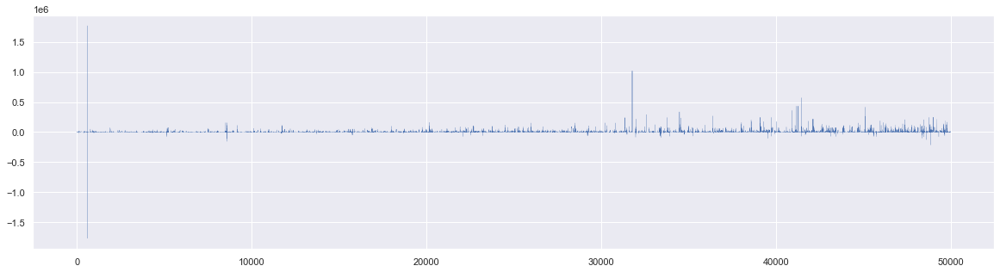

In [36]:
sns.set(rc={'figure.figsize':(20, 5)})

# 1er Gráfico 
ts['price_subtotal_signed'].plot(linewidth=0.2) 

Aquí nos encontramos con la primer visualización. A destacar, hay una linea al comienzo de la serie que está por fuera de todo comportamiento habitual subsigiente.

Debido a la característica del gráfico, sabemos que es al inicio pero no sabemos específicamente en qué fecha sucede.

Quitando esas imputaciones, encontramos valores negativos (que no deberían existir por definición), así como picos altos. Hay uno particular en el quito cuadrante que está muy por encima del resto.

### Índice por Fecha

Procedemos a cambiar el índice a fecha para una mayor comodidad:

In [37]:
ts = ts.set_index('date')
ts

,price_subtotal_signed
date,
2018-07-12,1562.18
2018-07-12,3466.00
2018-07-12,4332.00
2018-07-12,4332.00
2018-07-12,563.04
...,...
2021-04-28,5814.11
2021-04-28,5814.11
2021-04-28,5814.11


#### Observación por Año

In [38]:
ts['Year'] = ts.index.year
ts

,price_subtotal_signed,Year
date,,
2018-07-12,1562.18,2018
2018-07-12,3466.00,2018
2018-07-12,4332.00,2018
2018-07-12,4332.00,2018
2018-07-12,563.04,2018
...,...,...
2021-04-28,5814.11,2021
2021-04-28,5814.11,2021
2021-04-28,5814.11,2021


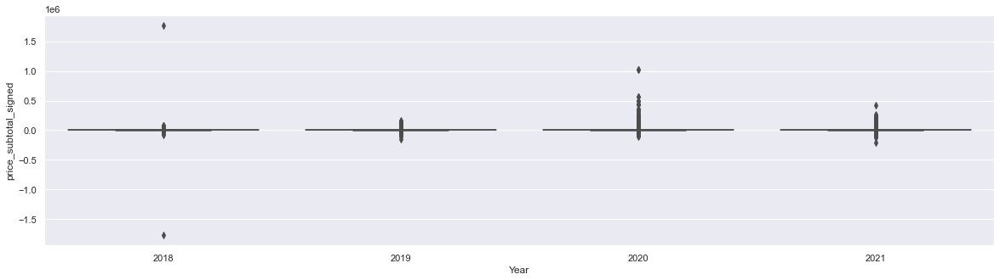

In [39]:
sns.set(rc={'figure.figsize':(20, 5)})
sns.boxplot(data=ts,x='Year',y='price_subtotal_signed')

Si nos acatamos a un análisis de outliers por año, nos encontramos con los dos puntos del 2018, y el punto del 2020, que ya habíamos podido apreciar en el gráfico de lineas de forma menos visual.

#### Observación por Mes

In [40]:
ts['Month'] = ts.index.month
ts

,price_subtotal_signed,Year,Month
date,,,
2018-07-12,1562.18,2018,7
2018-07-12,3466.00,2018,7
2018-07-12,4332.00,2018,7
2018-07-12,4332.00,2018,7
2018-07-12,563.04,2018,7
...,...,...,...
2021-04-28,5814.11,2021,4
2021-04-28,5814.11,2021,4
2021-04-28,5814.11,2021,4


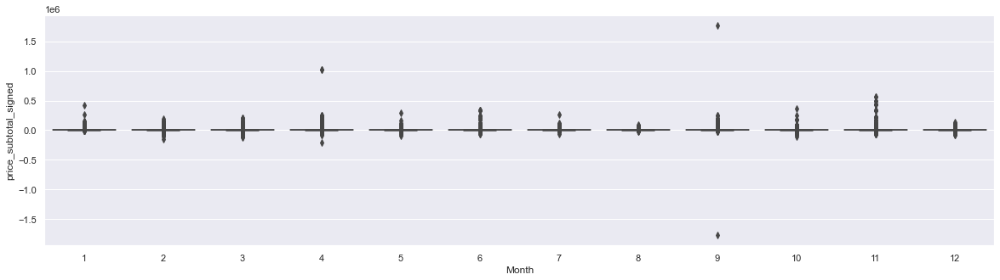

In [41]:
sns.set(rc={'figure.figsize':(20, 5)})
sns.boxplot(data=ts,x='Month',y='price_subtotal_signed')

Si pasamos a un análisis estrictamente mensual, bajo una perspectiva estacional, podríamos decir que en abril y en septiembre se encuentran los datos que están más por fuera de la media.

Seguramente, estos sean los meses involucrados en las transacciones del 2018 y el 2020 detectados previamente.

#### Observación por Día

In [42]:
ts['Day'] = ts.index.day
ts

,price_subtotal_signed,Year,Month,Day
date,,,,
2018-07-12,1562.18,2018,7,12
2018-07-12,3466.00,2018,7,12
2018-07-12,4332.00,2018,7,12
2018-07-12,4332.00,2018,7,12
2018-07-12,563.04,2018,7,12
...,...,...,...,...
2021-04-28,5814.11,2021,4,28
2021-04-28,5814.11,2021,4,28
2021-04-28,5814.11,2021,4,28


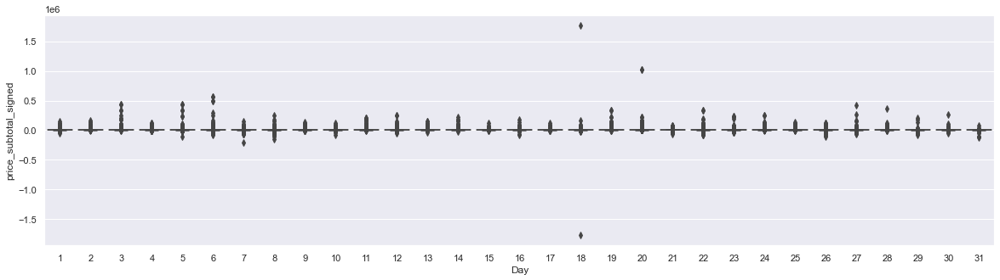

In [43]:
sns.set(rc={'figure.figsize':(20, 5)})
sns.boxplot(data=ts,x='Day',y='price_subtotal_signed')

Aqui podemos observar que el día 18 y el día 20 del mes, indistintamente del mes y año observado, tenemos 3 claros outliers.
Seguramente, dado como venimos evidenciando en los gráficos, el día 18 es el que genera la linea del 2018 y, el día 20, el que genera el pico positivo del 2020.

Aún nos queda continuar explorando. 

### Remuestreo

El suavisado de datos se puede realizar de diversas formas. Una de ellas es resampleando la información por día, por mes, por año... O elegir criterios como la sumatoria o el promedio.

A continuación, visualizaremos dos datos actuales, utilizando estas técnicas.

#### Acumulado por día

In [44]:
# Resampleo los datos para agrupar por acumulado diario
st_D1 = pd.DataFrame()

st_D1['price_subtotal_signed'] = ts['price_subtotal_signed'].resample('D').sum()
st_D1['Year'] = st_D1.index.year
st_D1['Month'] = st_D1.index.month
st_D1['Day'] = st_D1.index.day
st_D1

,price_subtotal_signed,Year,Month,Day
date,,,,
2018-07-12,47142.43,2018,7,12
2018-07-13,8868.30,2018,7,13
2018-07-14,0.00,2018,7,14
2018-07-15,0.00,2018,7,15
2018-07-16,47238.44,2018,7,16
...,...,...,...,...
2021-04-24,0.00,2021,4,24
2021-04-25,0.00,2021,4,25
2021-04-26,548639.93,2021,4,26


#### Promedio por día

In [45]:
# Resampleo los datos para agrupar por promedio diario
st_D2 = pd.DataFrame()

st_D2['price_subtotal_signed'] = ts['price_subtotal_signed'].resample('D').mean()
st_D2['Year'] = st_D1.index.year
st_D2['Month'] = st_D1.index.month
st_D2['Day'] = st_D1.index.day
st_D2

,price_subtotal_signed,Year,Month,Day
date,,,,
2018-07-12,2773.08,2018,7,12
2018-07-13,985.37,2018,7,13
2018-07-14,nan,2018,7,14
2018-07-15,nan,2018,7,15
2018-07-16,1816.86,2018,7,16
...,...,...,...,...
2021-04-24,nan,2021,4,24
2021-04-25,nan,2021,4,25
2021-04-26,23853.91,2021,4,26


Al tomar el promedio, y los valores iniciales tener ceros, es necesario tratarlos:

In [46]:
# Fillnan
st_D2.fillna(0,inplace=True)
st_D2

,price_subtotal_signed,Year,Month,Day
date,,,,
2018-07-12,2773.08,2018,7,12
2018-07-13,985.37,2018,7,13
2018-07-14,0.00,2018,7,14
2018-07-15,0.00,2018,7,15
2018-07-16,1816.86,2018,7,16
...,...,...,...,...
2021-04-24,0.00,2021,4,24
2021-04-25,0.00,2021,4,25
2021-04-26,23853.91,2021,4,26


#### Medias Móviles
Conocida en inglés como "moving average", es el promedio respecto a una ventana temporal indicada.

In [47]:
# Media móvil = Moving Average = MA
# Ventana temporal 7 días
# MA d7

st_D3 = st_D2.rolling(7).mean()
st_D3.head(10)

,price_subtotal_signed,Year,Month,Day
date,,,,
2018-07-12,nan,nan,nan,nan
2018-07-13,nan,nan,nan,nan
2018-07-14,nan,nan,nan,nan
2018-07-15,nan,nan,nan,nan
2018-07-16,nan,nan,nan,nan
2018-07-17,nan,nan,nan,nan
2018-07-18,1113.22,2018.00,7.00,15.00
2018-07-19,874.28,2018.00,7.00,16.00
2018-07-20,733.51,2018.00,7.00,17.00


In [48]:
# Media móvil = Moving Average = MA
# Ventana temporal 14 días
# MA d14

st_D4 = st_D2.rolling(14).mean()
st_D4

,price_subtotal_signed,Year,Month,Day
date,,,,
2018-07-12,nan,nan,nan,nan
2018-07-13,nan,nan,nan,nan
2018-07-14,nan,nan,nan,nan
2018-07-15,nan,nan,nan,nan
2018-07-16,nan,nan,nan,nan
...,...,...,...,...
2021-04-24,3938.51,2021.00,4.00,17.50
2021-04-25,3938.51,2021.00,4.00,18.50
2021-04-26,4038.97,2021.00,4.00,19.50


#### Acumulado por semana

In [49]:
# Resampleo los datos para agrupar por semana

st_W1 = pd.DataFrame()

st_W1['price_subtotal_signed'] = ts['price_subtotal_signed'].resample('W').sum()
st_W1['Year'] = st_W1.index.year
st_W1['Month'] = st_W1.index.month
st_W1['Day'] = st_W1.index.day
st_W1

,price_subtotal_signed,Year,Month,Day
date,,,,
2018-07-15,56010.73,2018,7,15
2018-07-22,74123.40,2018,7,22
2018-07-29,0.00,2018,7,29
2018-08-05,0.00,2018,8,5
2018-08-12,0.00,2018,8,12
...,...,...,...,...
2021-04-04,951810.41,2021,4,4
2021-04-11,2668765.47,2021,4,11
2021-04-18,3506847.20,2021,4,18


#### Promedio por Semana

In [50]:
# Resampleo nuestros datos para promediar por semana
st_W2 = pd.DataFrame()

st_W2['price_subtotal_signed'] = ts['price_subtotal_signed'].resample('W').mean()
st_W2['Year'] = st_W2.index.year
st_W2['Month'] = st_W2.index.month
st_W2['Day'] = st_W2.index.day
st_W2

,price_subtotal_signed,Year,Month,Day
date,,,,
2018-07-15,2154.26,2018,7,15
2018-07-22,1453.40,2018,7,22
2018-07-29,nan,2018,7,29
2018-08-05,nan,2018,8,5
2018-08-12,nan,2018,8,12
...,...,...,...,...
2021-04-04,4306.83,2021,4,4
2021-04-11,7331.77,2021,4,11
2021-04-18,8701.85,2021,4,18


## Gráficos
Graficamos las series temporales resultantes para evaluar su comportamiento.

### Con matplotlib

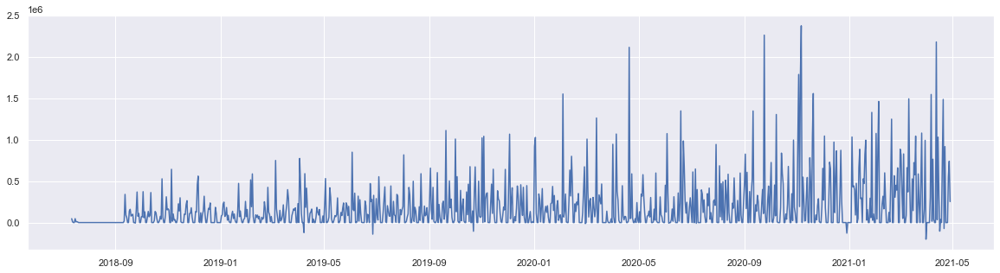

In [51]:
plt.figure(figsize=(20,5))
plt.plot(st_D1['price_subtotal_signed'],label='Acumulado')

En el acumulado por día, podemos observar que como era de esperarse, varios de los valores negativos se anulen con otros valores positivos. Y pasen a ser transparentes al ojo humano.

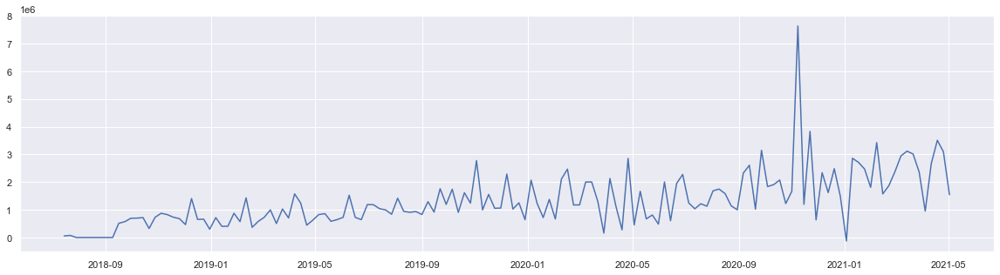

In [52]:
plt.figure(figsize=(20,5))
plt.plot(st_W1['price_subtotal_signed'],label='Acumulado')

En el acumulado semanal, es clara la simplificacion de la línea y sus picos. Se observa una ligera tendencia al aumento de ingresos, aunque sabemos que hay varios valores anulados en la sumatoria y deberíamos indagar cual sería su correcto tratamiento.

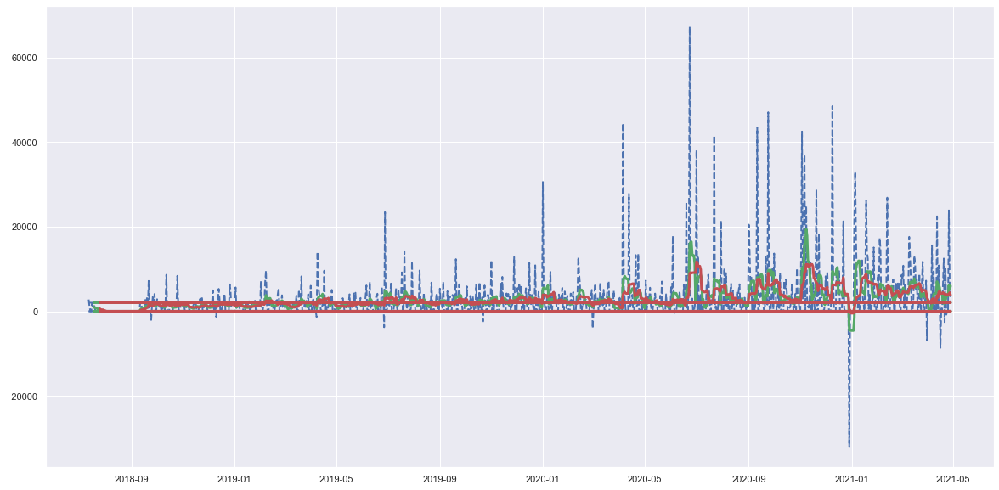

In [53]:
# OPCION 1 con matplotlib

plt.figure(figsize=(20,10))
plt.plot(st_D2,'b',label='Prom',linestyle=('--'),lw=2)
plt.plot(st_D2.rolling(7).mean(),'g',label='MA 7d',lw=3)
plt.plot(st_D2.rolling(14).mean(),'r',label='MA 14d',lw=3)

Generando una visualización rápida, podemos contrastar como el tratamiento de los datos impapta profundamente en sus valores.
Se denota el contraste entre el acumulado diario, y el promedio (como es de esperarse). Pero por sobre todo, también hay una gran diferencia entre la media móvil y sus ventanas temporales.

A continuación, evaluaremos con mayor presición los picos con otra libreria que nos da más herramientas para poder explorar los gráficos.

### Con Plotly

In [54]:
# Reseteo index para graficar

ts_ = ts.reset_index()

# Plot 
fig_1 = go.Figure()

fig_1.add_trace(go.Scatter(x=ts_['date'], y=ts_['price_subtotal_signed'],mode='lines',name='Ingreso'))

fig_1.update_xaxes(
    rangeslider_visible=True,
    rangeselector=dict(
        buttons=list([
            dict(count=1, label="1m", step="month", stepmode="backward"),
            dict(count=6, label="6m", step="month", stepmode="backward"),
            dict(count=1, label="YTD", step="year", stepmode="todate"),
            dict(count=1, label="1y", step="year", stepmode="backward"),
            dict(step="all")
        ])
    )
)
fig_1.update_layout(
    title="Ingresos por imputación - Zafrán",
    width=990,
    height=600,
)
fig_1.show()

#### Foco en outliers

In [55]:
fig_1.update_xaxes(range=['2018-09-10', '2018-09-29'])
fig_1.update_traces(
    mode='lines+markers'
)
fig_1.show()

Tal como podemos observar en el gráfico, el 18 de septiembre del 2018, tenemos varias imputaciones que salen completamente de lo habitual.

Esto es posible verlo sólo si graficamos las transacciones de forma independiente. Es decir, sin apelar a un acumulado o a un promedio.

Por el resto de los datos que se tienen, es claro que se trata de un comportamiento anómalo que no se repite en el tiempo. Y si bien, lo correcto sería indagar con los dueños de los datos la causa, en principio podríamos decir que no es reprentativo del comportamiento global. Y estaríamos hablando de un outlier o un error bastante grosero de carga.

In [56]:
ts.loc['2018-09-10':'2018-09-29']

,price_subtotal_signed,Year,Month,Day
date,,,,
2018-09-11,625.60,2018,9,11
2018-09-11,1684.34,2018,9,11
2018-09-11,1572.00,2018,9,11
2018-09-11,625.60,2018,9,11
2018-09-11,3582.72,2018,9,11
...,...,...,...,...
2018-09-28,1353.60,2018,9,28
2018-09-28,4060.80,2018,9,28
2018-09-28,918.75,2018,9,28


Si listamos las imputaciones comprendidas en ese rango de fechas, nos encontramos con que hay 1009. Con lo cual, y la mayoría de ellas muy por debajo de los valores outliers.
Con lo cual, nos encontramos ante un caso extraño.

Si acotamos la búsqueda:

In [57]:
ts.loc['2018-09-17':'2018-09-19']

,price_subtotal_signed,Year,Month,Day
date,,,,
2018-09-17,8121.60,2018,9,17
2018-09-17,13536.00,2018,9,17
2018-09-17,10828.80,2018,9,17
2018-09-17,783.22,2018,9,17
2018-09-17,783.22,2018,9,17
...,...,...,...,...
2018-09-19,5149.44,2018,9,19
2018-09-19,1205.40,2018,9,19
2018-09-19,1205.40,2018,9,19


Entre el 17 y el 19 se impactaron el 20% de los datos observados inicialmente en el rango. Esto continúa demostrando que el 18 sucedió algo fuera de lo habitual.

In [58]:
ts.loc['2018-09-18':'2018-09-18']

,price_subtotal_signed,Year,Month,Day
date,,,,
2018-09-18,281.52,2018,9,18
2018-09-18,281.52,2018,9,18
2018-09-18,281.52,2018,9,18
2018-09-18,8270.40,2018,9,18
2018-09-18,8270.40,2018,9,18
...,...,...,...,...
2018-09-18,233.40,2018,9,18
2018-09-18,116.70,2018,9,18
2018-09-18,116.70,2018,9,18


In [59]:
ts.loc['2018-09-18':'2018-09-18'].max()

price_subtotal_signed    1770240.00
Year                        2018.00
Month                          9.00
Day                           18.00
dtype: float64

In [60]:
ts.loc['2018-09-18':'2018-09-18'].min()

price_subtotal_signed   -1770240.00
Year                        2018.00
Month                          9.00
Day                           18.00
dtype: float64

Si acotamos la búsqueda al día 18, encontramos que hay 123 imputaciones. Lo cual sigue siendo una gran cantidad.
Al analizar el mínimo y el máximo nos encontramos que hay 2 transacciones con el mismo valor que se anulan entre sí.

In [61]:
df.loc[
    (df['invoice_date_invoice'] == '2018-09-18')   
].min()

invoice_line_id                                                       1403
invoice_line_origin                                              SO0000280
price_unit                                                            0.00
price_subtotal                                                        0.00
currency_id                                                             20
partner_id                                                            2601
account_id                                                             166
discount                                                              0.00
price_subtotal_signed                                          -1770240.00
invoice_line_name        779551590000 161073 BARRA ZAFRAN ALMENDRAS Y C...
product_id                                                             208
invoice_id                                                             572
quantity                                                              1.00
account_id_account       

Para este caso, no se cuenta con precio unitario. La cantidad de producto es 1, con lo cual tampoco podría ser que se haya realizado un pedido de un stock extremo.

In [62]:
df.loc[
    (df['invoice_date_invoice'] == '2018-09-18')   
].max()

invoice_line_id                                                       1532
invoice_line_origin                                              SO0000319
price_unit                                                         1353.60
price_subtotal                                                  1770240.00
currency_id                                                             20
partner_id                                                            4891
account_id                                                             169
discount                                                            100.00
price_subtotal_signed                                           1770240.00
invoice_line_name        [MIX008x60] SNACK | Almendras y maní picante d...
product_id                                                            2934
invoice_id                                                             591
quantity                                                          10000.00
account_id_account       

Para este caso, podemos observar que:
- Son mil unidades. 
- No pertenece a la misma factura que el item anterior.
- Tiene precio unitario.
- Si se multiplicara precio unitario por cantidad el ingreso sería de 1,3 millones.
- Si se aplicara el descuento especificado, el ingreso sería cero.


No hay coherencia con los datos. Se evidencia un error de carga.

#### Propuesta de tratamiento

Si realizamos una depuración rápida pasando a valores absolutos la variable `price_subtotal_signed` podremos explorar rapidamente los outliers en un gráfico.


In [63]:
ts['price'] =  ts['price_subtotal_signed'].abs()
ts['dates'] =  ts.index
ts

,price_subtotal_signed,Year,Month,Day,price,dates
date,,,,,,
2018-07-12,1562.18,2018,7,12,1562.18,2018-07-12
2018-07-12,3466.00,2018,7,12,3466.00,2018-07-12
2018-07-12,4332.00,2018,7,12,4332.00,2018-07-12
2018-07-12,4332.00,2018,7,12,4332.00,2018-07-12
2018-07-12,563.04,2018,7,12,563.04,2018-07-12
...,...,...,...,...,...,...
2021-04-28,5814.11,2021,4,28,5814.11,2021-04-28
2021-04-28,5814.11,2021,4,28,5814.11,2021-04-28
2021-04-28,5814.11,2021,4,28,5814.11,2021-04-28


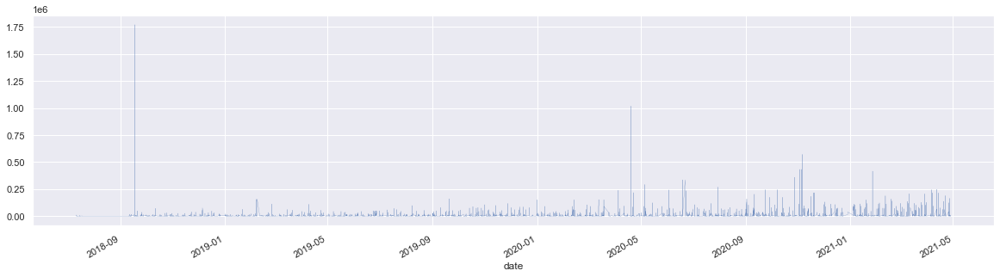

In [64]:
sns.set(rc={'figure.figsize':(20, 5)})

# 1er Gráfico 
ts['price'].plot(linewidth=0.2) 

Claramente esto cambia la perspectiva de los datos. Ya no contamos con negativos y los picos son mucho mas pronunciados.

Más allá de este tratamiento, hemos descubierto que también sería oportuno quitar los `cancelados`.

Por lo tanto, para realizar un mejor análisis aconsejamos:
- Pasar a valores absolutos los ingresos
- Quitar las imputaciones con estado cancelado
- Quitar las imputaciones sin fecha
- Tratar los outliers

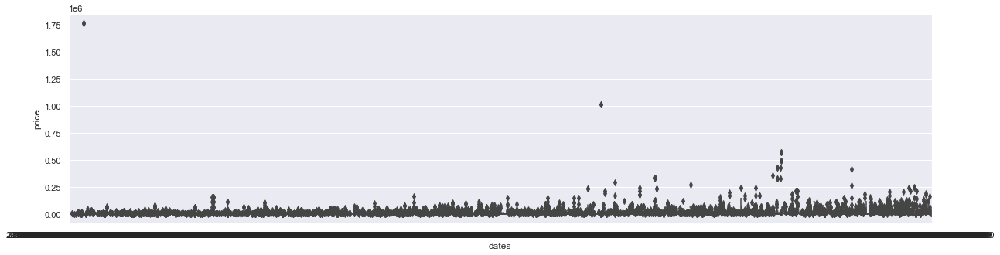

In [65]:
sns.set(rc={'figure.figsize':(20, 5)})
sns.boxplot(data=ts,x='dates',y='price')

In [66]:
fig = px.histogram(ts, x="dates", y="price", histfunc="avg", title="Diagrama de dispersión sobre días agrupado por mes")
fig.update_traces(xbins_size="M1")
fig.update_xaxes(showgrid=True, ticklabelmode="period", dtick="M1", tickformat="%b\n%Y")
fig.update_layout(bargap=0.1)
fig.add_trace(go.Scatter(mode="markers", x=ts["dates"], y=ts["price"], name="daily"))
fig.show()

En el gráfico resultante se puede apreciar:
- El espacio vacío que hay en la linea temporal en agosto de 2018
- El outlier de sep 2018
- El oulier de abr 2020
- Los otros outliers que se encuentras achatados por los anteriores

In [67]:
ts_filtered = ts.loc[
    (ts['dates'] >= '2018-09-01') &
    (ts['price'] <= 1000000)  
]
ts_filtered

,price_subtotal_signed,Year,Month,Day,price,dates
date,,,,,,
2018-09-11,625.60,2018,9,11,625.60,2018-09-11
2018-09-11,1684.34,2018,9,11,1684.34,2018-09-11
2018-09-11,1572.00,2018,9,11,1572.00,2018-09-11
2018-09-11,625.60,2018,9,11,625.60,2018-09-11
2018-09-11,3582.72,2018,9,11,3582.72,2018-09-11
...,...,...,...,...,...,...
2021-04-28,5814.11,2021,4,28,5814.11,2021-04-28
2021-04-28,5814.11,2021,4,28,5814.11,2021-04-28
2021-04-28,5814.11,2021,4,28,5814.11,2021-04-28


Con ese filtrado inicial, se descartan:

In [68]:
ts.count()-ts_filtered.count()

price_subtotal_signed    81
Year                     81
Month                    81
Day                      81
price                    81
dates                    81
dtype: int64

81 imputaciones de la base de datos.

In [69]:
fig = px.histogram(ts_filtered, x="dates", y="price", histfunc="avg", title="Diagrama de dispersión sobre días agrupado por mes F1")
fig.update_traces(xbins_size="M1")
fig.update_xaxes(showgrid=True, ticklabelmode="period", dtick="M1", tickformat="%b\n%Y")
fig.update_layout(bargap=0.1)
fig.add_trace(go.Scatter(mode="markers", x=ts_filtered["dates"], y=ts_filtered["price"], name="daily"))
fig.show()

Ahora si, la interpretación de outliers cambia drásticamente. Es decir, los datos dejan de estar aplastados por las 81 imputaciones que superan el millon de pesos.

Dado como se muestran los datos, creo conveniente tomar como muestra las imputaciones que no superen los 400k.

#### Suavizado

Con los datos originales

In [70]:
# Reseteo index para graficar

st_D1_ = st_D1.reset_index()

# Plot 
fig_2 = go.Figure()

fig_2.add_trace(go.Scatter(x=st_D1_['date'], y=st_D1_['price_subtotal_signed'],mode='lines',name='Acumulado'))

fig_2.update_xaxes(
    rangeslider_visible=True,
    rangeselector=dict(
        buttons=list([
            dict(count=1, label="1m", step="month", stepmode="backward"),
            dict(count=6, label="6m", step="month", stepmode="backward"),
            dict(count=1, label="YTD", step="year", stepmode="todate"),
            dict(count=1, label="1y", step="year", stepmode="backward"),
            dict(step="all")
        ])
    )
)
fig_2.update_layout(
    title="Ingresos Acumulados por día - Zafrán",
    width=990,
    height=600,
)
fig_2.show()

Al graficar el acumulado diario, al sumar las transacciones diarias, nos encontramos con que ambas operaciones se anulan y desaparece esa anomalía.
Aunque si, tratáramos los negativos con la función de "absolutos" previo a quitar y/o analizar esta situación, estaríamos contemplando un pico en los ingresos que queda muy por afuera de lo representado en el resto de los datos.

In [71]:
# Reseteo index para graficar

st_D2_ = st_D2.reset_index()
st_D3_ = st_D3.reset_index()


# Plot 
fig_3 = go.Figure()

fig_3.add_trace(go.Scatter(x=st_D2_['date'], y=st_D2_['price_subtotal_signed'],mode='lines',name='Mean D'))
fig_3.add_trace(go.Scatter(x=st_D3_['date'], y=st_D3_['price_subtotal_signed'],mode='lines',name='MA 7d'))

fig_3.update_xaxes(
    rangeslider_visible=True,
    rangeselector=dict(
        buttons=list([
            dict(count=1, label="1m", step="month", stepmode="backward"),
            dict(count=6, label="6m", step="month", stepmode="backward"),
            dict(count=1, label="YTD", step="year", stepmode="todate"),
            dict(count=1, label="1y", step="year", stepmode="backward"),
            dict(step="all")
        ])
    )
)
fig_3.update_layout(
    title="Ingresos Promedio por día - Zafrán",
    width=990,
    height=600,
)
fig_3.show()

En este caso, es posible observar como la interpretación de los datos cambia drásticamente si, en vez de utilizar el promedio, se utiliza la media móvil con una ventana temporal de 7 días.
Como es de esperar, el suavizado de los datos genera una curva más planchada y menos prominente.

In [72]:
# Reseteo index para graficar
st_D4_ = st_D4.reset_index()
st_W2_ = st_W2.reset_index()

# Plot 
fig_3.add_trace(go.Scatter(x=st_D4_['date'], y=st_D4_['price_subtotal_signed'],
                    mode='lines',
                    name='MA 14d'))
fig_3.add_trace(go.Scatter(x=st_W2_['date'], y=st_W2_['price_subtotal_signed'],
                    mode='lines',
                    name='Mean W'))

fig_3.show()

Si graficamos la media móvil de 14 días y el promedio semanal, a diferencia del promedio diario contamos con otro tipo de información en donde para el caso del promedio semanal por ejemplo, sigue apareciendo el pico negativo de 3 de enero, pero los picos positivos se aplanan.

In [73]:
fig_3.update_xaxes(range=['2020-12-01', '2021-04-01'])
fig_3.show()

Siendo este pico negativo el que más se destaca, al hacer foco en el mismo podriamos concluir que la media movil de 7 días sería lo más representativo respecto a la tendencia, siempre y cuando no se corrijan los datos (que claramente tienen inconcistencias).

## Conclusiones de r00_ventas

Contamos con una base de datos con errores:
- Los ingresos, tal como son tratados desde su definición y por el tipo de imputaciones que representan, no existe posibilidad que sean negativos.
- Se deben tratar los datos.
- Hay outliers de gran magnitud.
- La calidad de los datos debe ser cuestionada.
- El tratamiento de los mismos trasciende al hecho de sólo tratar nulos, blancos y outliers.

Debido a la calidad de los datos encontrados decido no analizar la tendencia y estacionalidad con ellos. Previamente creo conveniente realizar una limpieza de los mismos.

# Ventas (r02_ventas_fix)

r02_ventas_fix_sin_outliers

In [74]:
r02_ventas = pd.read_csv(input_folder + 'r02_ventas_fix_sin_outliers.csv')
r02_ventas

,invoice_line_id,invoice_line_origin,price_unit,price_subtotal,currency_id,partner_id,account_id,discount,price_subtotal_signed,invoice_line_name,product_id,invoice_id,quantity,account_id_account,account_code,account_name,invoice_date_invoice,invoice_state,partner_name,partner_city,partner_zip,partner_country_id,partner_state_id,customer,partner_market_category,product_weight,product_default_code,product_barcode,product_volume,product_sale_ok,product_uom,product_uom_factor,product_brand,product_pack_cat_name,product_pack_cat_qty,product_category,product_flavor,order_line_id,salesman_id,periodo,date_periodo,ingresos,provincia,ciudad
0,109,SO0000009,1562.18,1562.18,20,4671,166,0.00,1562.18,[BAR001x8x12] BARRA | Almendras y coco 8 disp ...,217,74,1.00,166,4.1.1.01.004,Ventas barras,2018-07-12,paid,Cliente 4671,NaN,NaN,nan,nan,t,NaN,2.69,BAR001x12x8,17798200000000.00,12.30,t,Caja 96u.,0.01,zafrán,BARx96,96,BAR,Combo Online,nan,nan,201807,2018-07-01,1562.18,NaN,NaN
1,110,SO0000009,1562.18,781.09,20,4671,166,0.00,781.09,[BAR002x8x12] BARRA | Maní y cacao 8 disp 12u ...,209,74,0.50,166,4.1.1.01.004,Ventas barras,2018-07-12,paid,Cliente 4671,NaN,NaN,nan,nan,t,NaN,2.69,BAR002x12x8,17798200000000.00,12.30,t,Caja 96u.,0.01,zafrán,BARx96,96,BAR,Maní y cacao,nan,nan,201807,2018-07-01,781.09,NaN,NaN
2,111,SO0000009,1562.18,781.09,20,4671,166,0.00,781.09,[BAR003x8x12] BARRA | Manzana y chía 8 disp 12...,230,74,0.50,166,4.1.1.01.004,Ventas barras,2018-07-12,paid,Cliente 4671,NaN,NaN,nan,nan,t,NaN,2.69,BAR003x12x8,17798200000000.00,12.30,t,Caja 96u.,0.01,zafrán,BARx96,96,BAR,Manzana y chía,nan,nan,201807,2018-07-01,781.09,NaN,NaN
3,112,SO0000009,1562.18,781.09,20,4671,166,0.00,781.09,[BAR004x8x12] BARRA | Cajú y semillas de zapal...,222,74,0.50,166,4.1.1.01.004,Ventas barras,2018-07-12,paid,Cliente 4671,NaN,NaN,nan,nan,t,NaN,2.69,BAR004x12x8,17798200000000.00,12.30,t,Caja 96u.,0.01,zafrán,BARx96,96,BAR,Cajú y semillas de zapallo,nan,nan,201807,2018-07-01,781.09,NaN,NaN
4,113,SO0000013,312.80,312.80,20,2626,168,0.00,312.80,"[GAL001x20] GALLETITA | Avena, pasas y chía 20...",249,75,1.00,168,4.1.1.01.002,Ventas galletitas,2018-07-13,paid,Cliente 2626,"Villa Maipu, San Martín",NaN,11.00,553.00,t,Distribuidor de Dietéticas,3.00,GAL001x20,17798200000000.00,16.60,t,Caja 20u.,0.05,zafrán,GALx20,20,GAL,"Avena, pasas y chía",nan,nan,201807,2018-07-01,312.80,Buenos Aires,"Villa Maipu, San Martín"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
49961,85434,SO0006522,1164.20,0.00,20,2614,168,100.00,0.00,[ZGAL001x20] GALLETITA ZAFRANITO | Vainilla 20...,3198,18711,2.00,168,4.1.1.01.002,Ventas galletitas,2021-04-28,open,Cliente 2614,NaN,NaN,11.00,552.00,t,Distribuidor de Dietéticas,3.00,ZGAL001x20,1.77982E+13,16.60,t,Caja 20u.,0.05,zafranito,zGALx20,20,GALZafranito,Vainilla,308914.00,7.00,202104,2021-04-01,0.00,Ciudad Autónoma de Buenos Aires,Ciudad Autónoma de Buenos Aires
49962,85435,SO0006522,1164.20,0.00,20,2614,168,100.00,0.00,[ZGAL002x20] GALLETITA ZAFRANITO | Cacao 20u x...,3204,18711,2.00,168,4.1.1.01.002,Ventas galletitas,2021-04-28,open,Cliente 2614,NaN,NaN,11.00,552.00,t,Distribuidor de Dietéticas,3.00,ZGAL002x20,1.77982E+13,16.60,t,Caja 20u.,0.05,zafranito,zGALx20,20,GALZafranito,Chocolate,308915.00,7.00,202104,2021-04-01,0.00,Ciudad Autónoma de Buenos Aires,Ciudad Autónoma de Buenos Aires
49963,85439,SO0006492,3442.56,6678.57,20,10354,166,3.00,6678.57,[BAR001x8x12] BARRA | Almendras y coco 8 disp ...,217,18714,2.00,166,4.1.1.01.004,Ventas barras,2021-04-28,open,Cliente 10354,NaN,NaN,11.00,552.00,t,Distribuidor de Kioskos,2.69,BAR001x12x8,1.77982E+13,12.30,t,Caja 96u.,0.01,zafrán,BARx96,96,BAR,Combo Online,307799.00,7.00,202104,2021-04-01,6678.57,Ciudad Autónoma de Buenos Aires,Ciudad Autónoma de Buenos Aires
49964,85440,SO0006492,3442.56,6678.57,20,10354,166,3.00,6678.57,[BAR002x8x12] BARRA | Maní y cacao 8 disp 12u

## EDA

In [75]:
df = r02_ventas.copy()

### Tipos de Variables

In [76]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 49966 entries, 0 to 49965
Data columns (total 44 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   invoice_line_id          49966 non-null  int64  
 1   invoice_line_origin      49736 non-null  object 
 2   price_unit               49966 non-null  float64
 3   price_subtotal           49966 non-null  float64
 4   currency_id              49966 non-null  int64  
 5   partner_id               49966 non-null  int64  
 6   account_id               49966 non-null  int64  
 7   discount                 49966 non-null  float64
 8   price_subtotal_signed    49966 non-null  float64
 9   invoice_line_name        49966 non-null  object 
 10  product_id               49966 non-null  int64  
 11  invoice_id               49966 non-null  int64  
 12  quantity                 49966 non-null  float64
 13  account_id_account       49966 non-null  int64  
 14  account_code          

In [77]:
# Transformar X columna a formato datetime
df['date'] = pd.to_datetime(df['invoice_date_invoice'])
df

,invoice_line_id,invoice_line_origin,price_unit,price_subtotal,currency_id,partner_id,account_id,discount,price_subtotal_signed,invoice_line_name,product_id,invoice_id,quantity,account_id_account,account_code,account_name,invoice_date_invoice,invoice_state,partner_name,partner_city,partner_zip,partner_country_id,partner_state_id,customer,partner_market_category,product_weight,product_default_code,product_barcode,product_volume,product_sale_ok,product_uom,product_uom_factor,product_brand,product_pack_cat_name,product_pack_cat_qty,product_category,product_flavor,order_line_id,salesman_id,periodo,date_periodo,ingresos,provincia,ciudad,date
0,109,SO0000009,1562.18,1562.18,20,4671,166,0.00,1562.18,[BAR001x8x12] BARRA | Almendras y coco 8 disp ...,217,74,1.00,166,4.1.1.01.004,Ventas barras,2018-07-12,paid,Cliente 4671,NaN,NaN,nan,nan,t,NaN,2.69,BAR001x12x8,17798200000000.00,12.30,t,Caja 96u.,0.01,zafrán,BARx96,96,BAR,Combo Online,nan,nan,201807,2018-07-01,1562.18,NaN,NaN,2018-07-12
1,110,SO0000009,1562.18,781.09,20,4671,166,0.00,781.09,[BAR002x8x12] BARRA | Maní y cacao 8 disp 12u ...,209,74,0.50,166,4.1.1.01.004,Ventas barras,2018-07-12,paid,Cliente 4671,NaN,NaN,nan,nan,t,NaN,2.69,BAR002x12x8,17798200000000.00,12.30,t,Caja 96u.,0.01,zafrán,BARx96,96,BAR,Maní y cacao,nan,nan,201807,2018-07-01,781.09,NaN,NaN,2018-07-12
2,111,SO0000009,1562.18,781.09,20,4671,166,0.00,781.09,[BAR003x8x12] BARRA | Manzana y chía 8 disp 12...,230,74,0.50,166,4.1.1.01.004,Ventas barras,2018-07-12,paid,Cliente 4671,NaN,NaN,nan,nan,t,NaN,2.69,BAR003x12x8,17798200000000.00,12.30,t,Caja 96u.,0.01,zafrán,BARx96,96,BAR,Manzana y chía,nan,nan,201807,2018-07-01,781.09,NaN,NaN,2018-07-12
3,112,SO0000009,1562.18,781.09,20,4671,166,0.00,781.09,[BAR004x8x12] BARRA | Cajú y semillas de zapal...,222,74,0.50,166,4.1.1.01.004,Ventas barras,2018-07-12,paid,Cliente 4671,NaN,NaN,nan,nan,t,NaN,2.69,BAR004x12x8,17798200000000.00,12.30,t,Caja 96u.,0.01,zafrán,BARx96,96,BAR,Cajú y semillas de zapallo,nan,nan,201807,2018-07-01,781.09,NaN,NaN,2018-07-12
4,113,SO0000013,312.80,312.80,20,2626,168,0.00,312.80,"[GAL001x20] GALLETITA | Avena, pasas y chía 20...",249,75,1.00,168,4.1.1.01.002,Ventas galletitas,2018-07-13,paid,Cliente 2626,"Villa Maipu, San Martín",NaN,11.00,553.00,t,Distribuidor de Dietéticas,3.00,GAL001x20,17798200000000.00,16.60,t,Caja 20u.,0.05,zafrán,GALx20,20,GAL,"Avena, pasas y chía",nan,nan,201807,2018-07-01,312.80,Buenos Aires,"Villa Maipu, San Martín",2018-07-13
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
49961,85434,SO0006522,1164.20,0.00,20,2614,168,100.00,0.00,[ZGAL001x20] GALLETITA ZAFRANITO | Vainilla 20...,3198,18711,2.00,168,4.1.1.01.002,Ventas galletitas,2021-04-28,open,Cliente 2614,NaN,NaN,11.00,552.00,t,Distribuidor de Dietéticas,3.00,ZGAL001x20,1.77982E+13,16.60,t,Caja 20u.,0.05,zafranito,zGALx20,20,GALZafranito,Vainilla,308914.00,7.00,202104,2021-04-01,0.00,Ciudad Autónoma de Buenos Aires,Ciudad Autónoma de Buenos Aires,2021-04-28
49962,85435,SO0006522,1164.20,0.00,20,2614,168,100.00,0.00,[ZGAL002x20] GALLETITA ZAFRANITO | Cacao 20u x...,3204,18711,2.00,168,4.1.1.01.002,Ventas galletitas,2021-04-28,open,Cliente 2614,NaN,NaN,11.00,552.00,t,Distribuidor de Dietéticas,3.00,ZGAL002x20,1.77982E+13,16.60,t,Caja 20u.,0.05,zafranito,zGALx20,20,GALZafranito,Chocolate,308915.00,7.00,202104,2021-04-01,0.00,Ciudad Autónoma de Buenos Aires,Ciudad Autónoma de Buenos Aires,2021-04-28
49963,85439,SO0006492,3442.56,6678.57,20,10354,166,3.00,6678.57,[BAR001x8x12] BARRA | Almendras y coco 8 disp ...,217,18714,2.00,166,4.1.1.01.004,Ventas barras,2021-04-28,open,Cliente 10354,NaN,NaN,11.00,552.00,t,Distribuidor de Kioskos,2.69,BAR001x12x8,1.77982E+13,12.30,t,Caja 96u.,0.01,zafrán,BARx96,96,BAR,Combo Online,307799.00,7.00,202104,2021-04-01,6678.57,Ciudad Autónoma de Buenos Aires,Ciudad Autónoma de Buenos Aires,2021-04-28
49964,85440,

In [78]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 49966 entries, 0 to 49965
Data columns (total 45 columns):
 #   Column                   Non-Null Count  Dtype         
---  ------                   --------------  -----         
 0   invoice_line_id          49966 non-null  int64         
 1   invoice_line_origin      49736 non-null  object        
 2   price_unit               49966 non-null  float64       
 3   price_subtotal           49966 non-null  float64       
 4   currency_id              49966 non-null  int64         
 5   partner_id               49966 non-null  int64         
 6   account_id               49966 non-null  int64         
 7   discount                 49966 non-null  float64       
 8   price_subtotal_signed    49966 non-null  float64       
 9   invoice_line_name        49966 non-null  object        
 10  product_id               49966 non-null  int64         
 11  invoice_id               49966 non-null  int64         
 12  quantity                 49966 n

### Estadísticos

In [79]:
df.describe()

,invoice_line_id,price_unit,price_subtotal,currency_id,partner_id,account_id,discount,price_subtotal_signed,product_id,invoice_id,quantity,account_id_account,partner_country_id,partner_state_id,product_weight,product_volume,product_uom_factor,product_pack_cat_qty,order_line_id,salesman_id,periodo,ingresos
count,49966.00,49966.00,49966.00,49966.00,49966.00,49966.00,49966.00,49966.00,49966.00,49966.00,49966.00,49966.00,45705.00,45411.00,49938.00,49938.00,49966.00,49966.00,47592.00,47592.00,49966.00,49966.00
mean,41217.03,917.12,4134.58,20.00,16451.91,179.53,3.07,3735.38,818.71,9088.68,19.22,179.53,11.00,555.05,1.87,7.68,0.22,54.66,128787.55,5.38,201954.77,4134.76
std,25430.06,857.88,12653.91,0.00,26828.87,77.55,10.11,12777.45,1151.63,5509.13,161.80,77.55,0.11,9.78,1.63,6.13,0.39,32.79,114152.65,2.60,84.33,12653.85
min,109.00,0.00,-1598.87,20.00,2601.00,166.00,0.00,-215472.00,208.00,74.00,-24.00,166.00,6.00,433.00,0.02,0.09,0.01,7.00,3620.00,1.00,201807.00,0.00
25%,19358.25,311.82,403.80,20.00,2763.00,166.00,0.00,360.33,223.00,4249.00,1.00,166.00,11.00,552.00,0.34,1.44,0.01,20.00,33777.75,1.00,201904.00,403.80
50%,37300.50,601.20,1218.24,20.00,4903.00,167.00,0.00,1155.85,248.00,8298.00,2.00,167.00,11.00,553.00,1.68,6.00,0.02,60.00,70284.50,7.00,201912.00,1218.24
75%,66082.75,1408.80,3006.00,20.00,9538.00,168.00,3.00,2907.60,271.00,14388.00,4.00,168.00,11.00,553.00,2.69,12.30,0.05,96.00,266910.25,7.00,202008.00,3006.00
max,85452.00,4918.08,359904.00,20.00,84454.00,666.00,100.00,359904.00,3467.00,18717.00,7680.00,666.00,11.00,647.00,7.00,20.00,1.00,96.00,309159.00,9.00,202104.00,359904.00


### Examino el tamaño

In [80]:
print('El dataframe tiene',df.shape[0],'filas y',df.shape[1],'columnas.')

El dataframe tiene 49966 filas y 45 columnas.


### Nulos y VA
Analizamos nulos y valores faltantes:

In [81]:
missing_zero_values_table(df)

,Zero Values,% of Zero Values,Missing Values,% of Missing Values,Total Missing Values,% Total Missing Values
discount,35254,70.60,0,0.00,35254,70.60
partner_zip,0,0.00,20915,41.90,20915,41.90
partner_market_category,0,0.00,10751,21.50,10751,21.50
partner_city,0,0.00,8719,17.40,8719,17.40
ciudad,0,0.00,4606,9.20,4606,9.20
partner_state_id,0,0.00,4555,9.10,4555,9.10
price_subtotal_signed,4549,9.10,0,0.00,4549,9.10
price_subtotal,4549,9.10,0,0.00,4549,9.10
ingresos,4549,9.10,0,0.00,4549,9.10
partner_country_id,0,0.00,4261,8.50,4261,8.50


'Your selected dataframe has 45 columns and 49966 Rows.\nThere are 18 columns that have missing values.'

### Duplicated

In [82]:
duplicates = df[df.duplicated()]
print('La cantidad de elementos duplicados es:', duplicates.shape[0])

La cantidad de elementos duplicados es: 0


### Imprimo las columnas del dataframe

In [83]:
print(print_columns(df))

#### List of columns:

| invoice_line_id | invoice_line_origin | price_unit | price_subtotal | currency_id | partner_id | account_id | discount | price_subtotal_signed | invoice_line_name | product_id | invoice_id | quantity | account_id_account | account_code | account_name | invoice_date_invoice | invoice_state | partner_name | partner_city | partner_zip | partner_country_id | partner_state_id | customer | partner_market_category | product_weight | product_default_code | product_barcode | product_volume | product_sale_ok | product_uom | product_uom_factor | product_brand | product_pack_cat_name | product_pack_cat_qty | product_category | product_flavor | order_line_id | salesman_id | periodo | date_periodo | ingresos | provincia | ciudad | date | 


### Examino la relación jerárquica de las variables

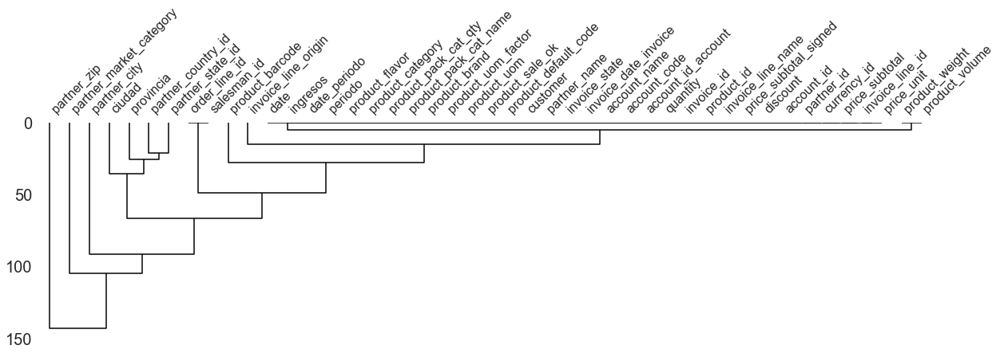

In [84]:
msno.dendrogram(df, figsize=(20, 5))

### Corr

In [85]:
graf_corr(df)

#### Correlation Table

,invoice_line_id,price_unit,price_subtotal,currency_id,partner_id,account_id,discount,price_subtotal_signed,product_id,invoice_id,quantity,account_id_account,partner_country_id,partner_state_id,product_weight,product_volume,product_uom_factor,product_pack_cat_qty,order_line_id,salesman_id,periodo,ingresos
invoice_line_id,1.00,0.30,0.14,nan,0.53,0.19,-0.02,0.13,0.19,1.00,0.03,0.19,0.00,0.01,-0.02,-0.01,0.03,-0.07,0.96,-0.18,0.94,0.14
price_unit,0.30,1.00,0.23,nan,-0.04,-0.03,0.06,0.20,-0.06,0.30,-0.10,-0.03,-0.04,0.03,0.51,0.49,-0.48,0.33,0.27,0.31,0.29,0.23
price_subtotal,0.14,0.23,1.00,nan,-0.09,-0.02,-0.02,0.89,0.07,0.14,0.39,-0.02,0.00,-0.05,0.17,0.15,-0.15,-0.00,0.13,0.16,0.13,1.00
currency_id,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
partner_id,0.53,-0.04,-0.09,nan,1.00,0.16,-0.08,-0.08,0.09,0.53,-0.05,0.16,0.01,0.00,-0.23,-0.26,0.21,-0.03,0.58,-0.53,0.47,-0.09
account_id,0.19,-0.03,-0.02,nan,0.16,1.00,-0.01,-0.02,0.35,0.19,-0.02,1.00,0.00,0.02,-0.08,-0.11,0.14,-0.24,0.21,-0.04,0.15,-0.02
discount,-0.02,0.06,-0.02,nan,-0.08,-0.01,1.00,-0.02,-0.01,-0.02,-0.03,-0.01,-0.02,0.06,0.12,0.13,-0.02,-0.02,-0.01,0.14,-0.02,-0.02
price_subtotal_signed,0.13,0.20,0.89,nan,-0.08,-0.02,-0.02,1.00,0.06,0.13,0.36,-0.02,0.00,-0.04,0.14,0.13,-0.14,0.00,0.13,0.16,0.12,0.89
product_id,0.19,-0.06,0.07,nan,0.09,0.35,-0.01,0.06,1.00,0.19,0.01,0.35,0.00,-0.02,-0.07,-0.03,-0.05,-0.14,0.19,0.10,0.18,0.07
invoice_id,1.00,0.30,0.14,nan,0.53,0.19,-0.02,0.13,0.19,1.00,0.03,0.19,0.00,0.01,-0.02,-0.01,0.03,-0.07,0.96,-0.18,0.94,0.14


,invoice_line_id,price_unit,price_subtotal,currency_id,partner_id,account_id,discount,price_subtotal_signed,product_id,invoice_id,quantity,account_id_account,partner_country_id,partner_state_id,product_weight,product_volume,product_uom_factor,product_pack_cat_qty,order_line_id,salesman_id,periodo,ingresos
invoice_line_id,1.00,0.30,0.14,nan,0.53,0.19,-0.02,0.13,0.19,1.00,0.03,0.19,0.00,0.01,-0.02,-0.01,0.03,-0.07,0.96,-0.18,0.94,0.14
price_unit,0.30,1.00,0.23,nan,-0.04,-0.03,0.06,0.20,-0.06,0.30,-0.10,-0.03,-0.04,0.03,0.51,0.49,-0.48,0.33,0.27,0.31,0.29,0.23
price_subtotal,0.14,0.23,1.00,nan,-0.09,-0.02,-0.02,0.89,0.07,0.14,0.39,-0.02,0.00,-0.05,0.17,0.15,-0.15,-0.00,0.13,0.16,0.13,1.00
currency_id,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
partner_id,0.53,-0.04,-0.09,nan,1.00,0.16,-0.08,-0.08,0.09,0.53,-0.05,0.16,0.01,0.00,-0.23,-0.26,0.21,-0.03,0.58,-0.53,0.47,-0.09
account_id,0.19,-0.03,-0.02,nan,0.16,1.00,-0.01,-0.02,0.35,0.19,-0.02,1.00,0.00,0.02,-0.08,-0.11,0.14,-0.24,0.21,-0.04,0.15,-0.02
discount,-0.02,0.06,-0.02,nan,-0.08,-0.01,1.00,-0.02,-0.01,-0.02,-0.03,-0.01,-0.02,0.06,0.12,0.13,-0.02,-0.02,-0.01,0.14,-0.02,-0.02
price_subtotal_signed,0.13,0.20,0.89,nan,-0.08,-0.02,-0.02,1.00,0.06,0.13,0.36,-0.02,0.00,-0.04,0.14,0.13,-0.14,0.00,0.13,0.16,0.12,0.89
product_id,0.19,-0.06,0.07,nan,0.09,0.35,-0.01,0.06,1.00,0.19,0.01,0.35,0.00,-0.02,-0.07,-0.03,-0.05,-0.14,0.19,0.10,0.18,0.07
invoice_id,1.00,0.30,0.14,nan,0.53,0.19,-0.02,0.13,0.19,1.00,0.03,0.19,0.00,0.01,-0.02,-0.01,0.03,-0.07,0.96,-0.18,0.94,0.14


## Time Series

### Generación de dataframe con sólo las columnas de interés

Finalmente, procedo a quedarme sólo con este grupo de variables de interés:

In [86]:
ts = df.loc[:, [
    'date',
    'product_brand',
    'ingresos',
    ]
]

In [87]:
#Reordenamos el dataset por fecha
ts.sort_values('date', inplace = True)
ts.reset_index(drop=True, inplace = True)

ts

,date,product_brand,ingresos
0,2018-07-12,zafrán,1562.18
1,2018-07-12,zafrán,10530.00
2,2018-07-12,zafrán,5850.00
3,2018-07-12,zafrán,5850.00
4,2018-07-12,zafrán,2775.00
...,...,...,...
49961,2021-04-28,zafrán,929.24
49962,2021-04-28,zafrán,2716.32
49963,2021-04-28,zafrán,3270.43
49964,2021-04-28,zafrán,3339.28


In [88]:
ts.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 49966 entries, 0 to 49965
Data columns (total 3 columns):
 #   Column         Non-Null Count  Dtype         
---  ------         --------------  -----         
 0   date           49966 non-null  datetime64[ns]
 1   product_brand  49966 non-null  object        
 2   ingresos       49966 non-null  float64       
dtypes: datetime64[ns](1), float64(1), object(1)
memory usage: 1.1+ MB


### Nulos

In [89]:
# elimino nulos
ts.dropna(inplace=True)

missing_zero_values_table(ts)

,Zero Values,% of Zero Values,Missing Values,% of Missing Values,Total Missing Values,% Total Missing Values
ingresos,4549,9.10,0,0.00,4549,9.10


'Your selected dataframe has 3 columns and 49966 Rows.\nThere are 1 columns that have missing values.'

### Índice por Fecha

In [90]:
ts = ts.set_index('date')
ts

,product_brand,ingresos
date,,
2018-07-12,zafrán,1562.18
2018-07-12,zafrán,10530.00
2018-07-12,zafrán,5850.00
2018-07-12,zafrán,5850.00
2018-07-12,zafrán,2775.00
...,...,...
2021-04-28,zafrán,929.24
2021-04-28,zafrán,2716.32
2021-04-28,zafrán,3270.43


In [91]:
print()

var = 'product_brand'
v1 = explore_var(ts[var],var,limit=10)
display(v1)
print()


There are **2** different value in the **product_brand** variable of the dataframe.

The list of the **2**  values:

,unique_values,counts
0,zafrán,48436
1,zafranito,1530


In [92]:
ts['ing_zafran'] = np.where(ts['product_brand'] == 'zafrán', ts['ingresos'],0)
ts['ing_zafranito'] = np.where(ts['product_brand'] == 'zafranito', ts['ingresos'],0)
ts

,product_brand,ingresos,ing_zafran,ing_zafranito
date,,,,
2018-07-12,zafrán,1562.18,1562.18,0.00
2018-07-12,zafrán,10530.00,10530.00,0.00
2018-07-12,zafrán,5850.00,5850.00,0.00
2018-07-12,zafrán,5850.00,5850.00,0.00
2018-07-12,zafrán,2775.00,2775.00,0.00
...,...,...,...,...
2021-04-28,zafrán,929.24,929.24,0.00
2021-04-28,zafrán,2716.32,2716.32,0.00
2021-04-28,zafrán,3270.43,3270.43,0.00


### Grafico Serie Temporal
Graficamos la serie temporal resultante para evaluar su comportamiento.

In [93]:
# Reseteo index para graficar

ts_ = ts.reset_index()
ts_

,date,product_brand,ingresos,ing_zafran,ing_zafranito
0,2018-07-12,zafrán,1562.18,1562.18,0.00
1,2018-07-12,zafrán,10530.00,10530.00,0.00
2,2018-07-12,zafrán,5850.00,5850.00,0.00
3,2018-07-12,zafrán,5850.00,5850.00,0.00
4,2018-07-12,zafrán,2775.00,2775.00,0.00
...,...,...,...,...,...
49961,2021-04-28,zafrán,929.24,929.24,0.00
49962,2021-04-28,zafrán,2716.32,2716.32,0.00
49963,2021-04-28,zafrán,3270.43,3270.43,0.00
49964,2021-04-28,zafrán,3339.28,3339.28,0.00


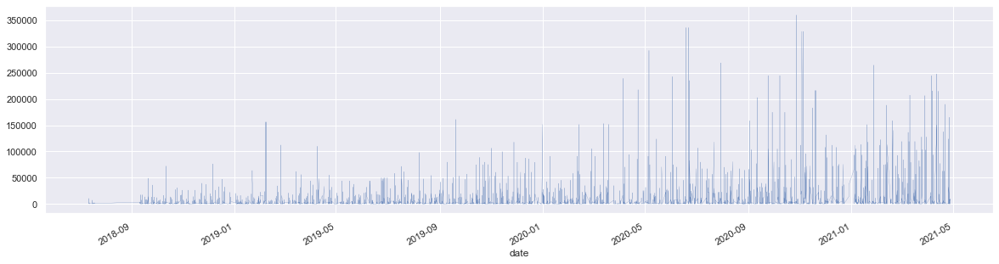

In [94]:
sns.set(rc={'figure.figsize':(20, 5)})

# 1er Gráfico 
ts['ingresos'].plot(linewidth=0.2)

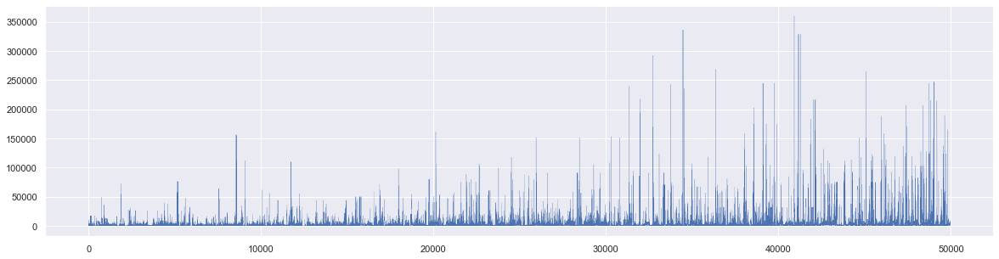

In [95]:
ts_['ingresos'].plot(linewidth=0.2)

In [96]:
# Plot 
fig_1 = go.Figure()

fig_1.add_trace(go.Scatter(x=ts_['date'], y=ts_['ingresos'],mode='lines',name='Total'))
fig_1.add_trace(go.Scatter(x=ts_['date'], y=ts_['ingresos'],mode='lines',name='Zafrán'))
fig_1.add_trace(go.Scatter(x=ts_['date'], y=ts_['ingresos'],mode='lines',name='Zafranito'))

fig_1.update_xaxes(
    rangeslider_visible=True,
    rangeselector=dict(
        buttons=list([
            dict(count=1, label="1m", step="month", stepmode="backward"),
            dict(count=6, label="6m", step="month", stepmode="backward"),
            dict(count=1, label="YTD", step="year", stepmode="todate"),
            dict(count=1, label="1y", step="year", stepmode="backward"),
            dict(step="all")
        ])
    )
)
fig_1.update_layout(
    title="Ingresos por imputación - Zafrán",
    width=990,
    height=500,
)
fig_1.show()

### Dispersión por día

In [97]:
fig = px.histogram(ts_, x="date", y="ingresos", histfunc="avg", title="Diagrama de dispersión sobre días agrupado por mes")
fig.update_traces(xbins_size="M1")
fig.update_xaxes(showgrid=True, ticklabelmode="period", dtick="M1", tickformat="%b\n%Y")
fig.update_layout(bargap=0.1)
fig.add_trace(go.Scatter(mode="markers", x=ts_["date"], y=ts_["ingresos"], name="daily"))
fig.show()

### Corr

In [98]:
df_brand_corr = ts.copy()
df_brand_corr.drop('ingresos', axis='columns', inplace=True)
df_brand_corr

,product_brand,ing_zafran,ing_zafranito
date,,,
2018-07-12,zafrán,1562.18,0.00
2018-07-12,zafrán,10530.00,0.00
2018-07-12,zafrán,5850.00,0.00
2018-07-12,zafrán,5850.00,0.00
2018-07-12,zafrán,2775.00,0.00
...,...,...,...
2021-04-28,zafrán,929.24,0.00
2021-04-28,zafrán,2716.32,0.00
2021-04-28,zafrán,3270.43,0.00


In [99]:
brand_corr = graf_corr(df_brand_corr)

#### Correlation Table

,ing_zafran,ing_zafranito
ing_zafran,1.00,-0.01
ing_zafranito,-0.01,1.00


In [100]:
# Guardo el resultado
brand_corr.to_csv(output_folder+'brand_corr.csv',index=False)

### Acumulado por día

Generamos un Remuestreo del dataset, con la sumatoria por día.

In [101]:
# Resampleo los datos para agrupar por acumulado diario
st_D1 = pd.DataFrame()

st_D1['ing_total'] = ts['ingresos'].resample('D').sum()
st_D1['ing_zafran'] = ts['ing_zafran'].resample('D').sum()
st_D1['ing_zafranito'] = ts['ing_zafranito'].resample('D').sum()
st_D1['Year'] = st_D1.index.year
st_D1['Month'] = st_D1.index.month
st_D1['Day'] = st_D1.index.day
st_D1

,ing_total,ing_zafran,ing_zafranito,Year,Month,Day
date,,,,,,
2018-07-12,47142.43,47142.43,0.00,2018,7,12
2018-07-13,8868.30,8868.30,0.00,2018,7,13
2018-07-14,0.00,0.00,0.00,2018,7,14
2018-07-15,0.00,0.00,0.00,2018,7,15
2018-07-16,47238.44,47238.44,0.00,2018,7,16
...,...,...,...,...,...,...
2021-04-24,0.00,0.00,0.00,2021,4,24
2021-04-25,0.00,0.00,0.00,2021,4,25
2021-04-26,580656.07,580656.07,0.00,2021,4,26


#### Gráfico
Graficamos la serie temporal resultante para evaluar su comportamiento.

In [102]:
# Reseteo index para graficar

st_D1_ = st_D1.reset_index()

# Plot 
fig_2 = go.Figure()

fig_2.add_trace(go.Scatter(x=st_D1_['date'], y=st_D1_['ing_total'],mode='lines',name='Acumulado T'))
fig_2.add_trace(go.Scatter(x=st_D1_['date'], y=st_D1_['ing_zafran'],mode='lines',name='Zafrán'))
fig_2.add_trace(go.Scatter(x=st_D1_['date'], y=st_D1_['ing_zafranito'],mode='lines',name='Zafranito'))

fig_2.update_xaxes(
    rangeslider_visible=True,
    rangeselector=dict(
        buttons=list([
            dict(count=1, label="1m", step="month", stepmode="backward"),
            dict(count=6, label="6m", step="month", stepmode="backward"),
            dict(count=1, label="YTD", step="year", stepmode="todate"),
            dict(count=1, label="1y", step="year", stepmode="backward"),
            dict(step="all")
        ])
    )
)
fig_2.update_layout(
    title="Ingresos Acumulados por día - Zafrán",
    width=990,
    height=600,
)
fig_2.show()

#### Autocorrelación

Los gráficos de autocorrelación son muy utilizados en el análisis y la predicción de series de tiempo.

Podemos calcular la correlación de las observaciones de series de tiempo con observaciones con pasos de tiempo anteriores, llamados retrasos. Debido a que la correlación de las observaciones de la serie temporal se calcula con valores de la misma serie en momentos anteriores, esto se denomina correlación en serie o autocorrelación.

El coeficiente de correlación es un número negativo o positivo que describe una correlación negativa o positiva respectivamente. Un valor de cero indica que no hay correlación.

A continuación utilizaremos función plot_acf () de la biblioteca statsmodels para calcular y trazar la gráfica de autocorrelación para los pasos de vehículos.

##### Un año

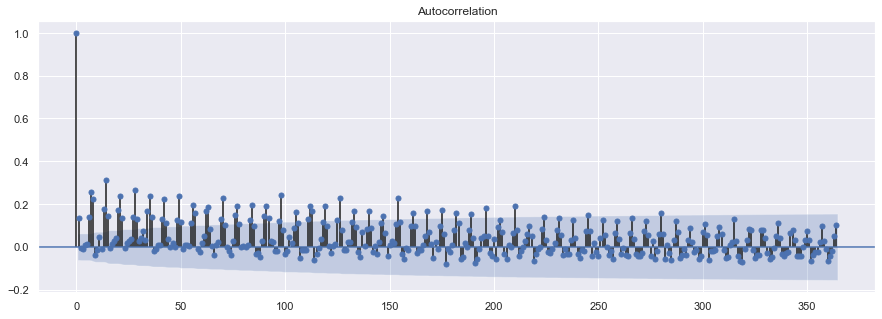

In [103]:
# Plot Autorcorrelación

days = 365 # Cantidad de días en 1 año.
years = 1 # Cantidad de años observados.

nlags= days*years    

#autocorr = stattools.acf(st_D1['ing_total'], nlags= nlags)
#autocorr.shape

plt.rcParams['figure.figsize'] = [15,5]
plot_acf(st_D1['ing_total'], lags = np.arange(nlags))
plt.show()

Este gráfico muestra el valor de retraso a lo largo del eje X, y la correlación en el eje Y entre -1 y 1.

Los intervalos de confianza se dibujan como un cono. De forma predeterminada, se establece en un intervalo de confianza del 95%, lo que sugiere que los valores de correlación fuera de este cono son muy probablemente una correlación y no una casualidad estadística.

##### Dos años

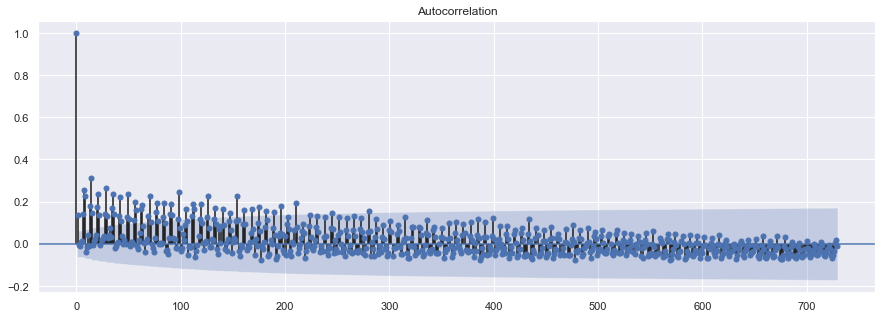

In [104]:
# Plot Autorcorrelación

days = 365 # Cantidad de días en 1 año.
years = 2 # Cantidad de años observados.

nlags= days*years    

plt.rcParams['figure.figsize'] = [15,5]
plot_acf(st_D1['ing_total'], lags = np.arange(nlags))
plt.show()

##### Conclusión de autocorrelación

Por el tipo de dataset con el que trabajamos, entiendo que es muy difícil poder apreciar y graficar la Autocorrelacion en una frecuencia diaria.

Es muy notorio como los datos de interés (zona no sombreada) se reducen a una pequeña parte.

### Promedio por día

In [105]:
# Resampleo los datos para agrupar por promedio diario
st_D2 = pd.DataFrame()

st_D2['ing_total'] = ts['ingresos'].resample('D').mean()
st_D2['ing_zafran'] = ts['ing_zafran'].resample('D').mean()
st_D2['ing_zafranito'] = ts['ing_zafranito'].resample('D').mean()
st_D2['Year'] = st_D1.index.year
st_D2['Month'] = st_D1.index.month
st_D2['Day'] = st_D1.index.day

st_D2

,ing_total,ing_zafran,ing_zafranito,Year,Month,Day
date,,,,,,
2018-07-12,2773.08,2773.08,0.00,2018,7,12
2018-07-13,985.37,985.37,0.00,2018,7,13
2018-07-14,nan,nan,nan,2018,7,14
2018-07-15,nan,nan,nan,2018,7,15
2018-07-16,1816.86,1816.86,0.00,2018,7,16
...,...,...,...,...,...,...
2021-04-24,nan,nan,nan,2021,4,24
2021-04-25,nan,nan,nan,2021,4,25
2021-04-26,25245.92,25245.92,0.00,2021,4,26


In [106]:
# Fillnan
st_D2.fillna(0,inplace=True)
st_D2

,ing_total,ing_zafran,ing_zafranito,Year,Month,Day
date,,,,,,
2018-07-12,2773.08,2773.08,0.00,2018,7,12
2018-07-13,985.37,985.37,0.00,2018,7,13
2018-07-14,0.00,0.00,0.00,2018,7,14
2018-07-15,0.00,0.00,0.00,2018,7,15
2018-07-16,1816.86,1816.86,0.00,2018,7,16
...,...,...,...,...,...,...
2021-04-24,0.00,0.00,0.00,2021,4,24
2021-04-25,0.00,0.00,0.00,2021,4,25
2021-04-26,25245.92,25245.92,0.00,2021,4,26


#### Gráfico

In [107]:
# Reset index
st_D2_ = st_D2.reset_index()

# Plot 
fig_4 = go.Figure()

fig_4.add_trace(go.Scatter(x=st_D2_['date'], y=st_D2_['ing_total'],mode='lines',name='Mean D - Total'))
fig_4.add_trace(go.Scatter(x=st_D2_['date'], y=st_D2_['ing_zafran'],mode='lines',name='Mean D - Zafrán'))
fig_4.add_trace(go.Scatter(x=st_D2_['date'], y=st_D2_['ing_zafranito'],mode='lines',name='Mean D - Zafranito'))

fig_4.update_xaxes(
    rangeslider_visible=True,
    rangeselector=dict(
        buttons=list([
            dict(count=1, label="1m", step="month", stepmode="backward"),
            dict(count=6, label="6m", step="month", stepmode="backward"),
            dict(count=1, label="YTD", step="year", stepmode="todate"),
            dict(count=1, label="1y", step="year", stepmode="backward"),
            dict(step="all")
        ])
    )
)
fig_4.update_layout(
    title="Ingresos Promedio por día - Zafrán",
    width=990,
    height=600,
)
fig_4.show()

### Medias Móviles
Conocida en inglés como "moving average", es el promedio respecto a una ventana temporal indicada.

In [108]:
# Media móvil = Moving Average = MA
# Ventana temporal 7 días
# MA d7

st_D3 = st_D2.rolling(7).mean()
st_D3.head(10)

,ing_total,ing_zafran,ing_zafranito,Year,Month,Day
date,,,,,,
2018-07-12,nan,nan,nan,nan,nan,nan
2018-07-13,nan,nan,nan,nan,nan,nan
2018-07-14,nan,nan,nan,nan,nan,nan
2018-07-15,nan,nan,nan,nan,nan,nan
2018-07-16,nan,nan,nan,nan,nan,nan
2018-07-17,nan,nan,nan,nan,nan,nan
2018-07-18,1113.22,1113.22,0.00,2018.00,7.00,15.00
2018-07-19,874.28,874.28,0.00,2018.00,7.00,16.00
2018-07-20,733.51,733.51,0.00,2018.00,7.00,17.00


In [109]:
# Media móvil = Moving Average = MA
# Ventana temporal 14 días
# MA d14

st_D4 = st_D2.rolling(14).mean()
st_D4

,ing_total,ing_zafran,ing_zafranito,Year,Month,Day
date,,,,,,
2018-07-12,nan,nan,nan,nan,nan,nan
2018-07-13,nan,nan,nan,nan,nan,nan
2018-07-14,nan,nan,nan,nan,nan,nan
2018-07-15,nan,nan,nan,nan,nan,nan
2018-07-16,nan,nan,nan,nan,nan,nan
...,...,...,...,...,...,...
2021-04-24,6395.28,6210.38,184.90,2021.00,4.00,17.50
2021-04-25,6395.28,6210.38,184.90,2021.00,4.00,18.50
2021-04-26,6595.16,6415.10,180.07,2021.00,4.00,19.50


#### Gráfico

In [110]:
# Reseteo index para graficar

st_D3_ = st_D3.reset_index()
st_D4_ = st_D4.reset_index()


# Plot 
fig_3 = go.Figure()

#fig_3.add_trace(go.Scatter(x=st_D2_['date'], y=st_D2_['ing_total'],mode='lines',name='Mean D'))
fig_3.add_trace(go.Scatter(x=st_D3_['date'], y=st_D3_['ing_total'],mode='lines',name='MA 7d'))
fig_3.add_trace(go.Scatter(x=st_D2_['date'], y=st_D4_['ing_total'],mode='lines',name='MA 14d'))

fig_3.update_xaxes(
    rangeslider_visible=True,
    rangeselector=dict(
        buttons=list([
            dict(count=1, label="1m", step="month", stepmode="backward"),
            dict(count=6, label="6m", step="month", stepmode="backward"),
            dict(count=1, label="YTD", step="year", stepmode="todate"),
            dict(count=1, label="1y", step="year", stepmode="backward"),
            dict(step="all")
        ])
    )
)
fig_3.update_layout(
    title="Ingresos por día - Media Móvil - Zafrán",
    width=990,
    height=600,
)
fig_3.show()

### Acumulado por semana

In [111]:
# Resampleo los datos para agrupar por semana

st_W1 = pd.DataFrame()

st_W1['ing_total'] = ts['ingresos'].resample('W').sum()
st_W1['ing_zafran'] = ts['ing_zafran'].resample('W').sum()
st_W1['ing_zafranito'] = ts['ing_zafranito'].resample('W').sum()

st_W1['Year'] = st_W1.index.year
st_W1['Month'] = st_W1.index.month
st_W1['Day'] = st_W1.index.day
st_W1

,ing_total,ing_zafran,ing_zafranito,Year,Month,Day
date,,,,,,
2018-07-15,56010.73,56010.73,0.00,2018,7,15
2018-07-22,74123.40,74123.40,0.00,2018,7,22
2018-07-29,0.00,0.00,0.00,2018,7,29
2018-08-05,0.00,0.00,0.00,2018,8,5
2018-08-12,0.00,0.00,0.00,2018,8,12
...,...,...,...,...,...,...
2021-04-04,2266605.73,2264260.39,2345.34,2021,4,4
2021-04-11,3140290.19,3009749.71,130540.48,2021,4,11
2021-04-18,3744450.28,3694329.76,50120.52,2021,4,18


#### Autocorrelación
##### Un año

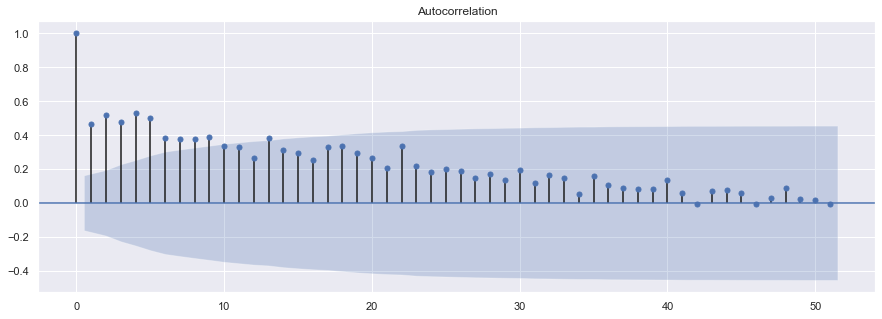

In [112]:
weeks = 52 # Cantidad de semanas en 1 año.
years = 1 # Cantidad de años observados.

nlags= weeks*years           

# Plot Autorcorrelación
plt.rcParams['figure.figsize'] = [15,5]
plot_acf(st_W1['ing_total'], lags = np.arange(nlags))
plt.show()

##### Dos años

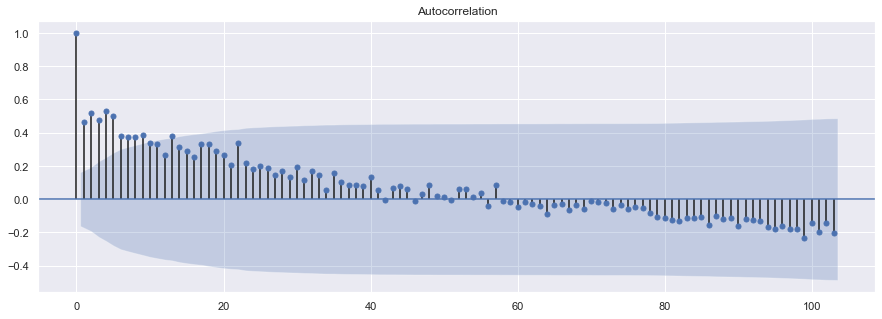

In [113]:
weeks = 52 # Cantidad de semanas en 1 año.
years = 2 # Cantidad de años observados.

nlags= weeks*years           

# Plot Autorcorrelación
plt.rcParams['figure.figsize'] = [15,5]
plot_acf(st_W1['ing_total'], lags = np.arange(nlags))
plt.show()

### Promedio por Semana

In [114]:
# Resampleo nuestros datos para promediar por semana
st_W2 = pd.DataFrame()

st_W2['ing_total'] = ts['ingresos'].resample('W').mean()
st_W2['ing_zafran'] = ts['ing_zafran'].resample('W').mean()
st_W2['ing_zafranito'] = ts['ing_zafranito'].resample('W').mean()

st_W2['Year'] = st_W2.index.year
st_W2['Month'] = st_W2.index.month
st_W2['Day'] = st_W2.index.day

# Fillnan
st_W2.fillna(0,inplace=True)
st_W2

,ing_total,ing_zafran,ing_zafranito,Year,Month,Day
date,,,,,,
2018-07-15,2154.26,2154.26,0.00,2018,7,15
2018-07-22,1453.40,1453.40,0.00,2018,7,22
2018-07-29,0.00,0.00,0.00,2018,7,29
2018-08-05,0.00,0.00,0.00,2018,8,5
2018-08-12,0.00,0.00,0.00,2018,8,12
...,...,...,...,...,...,...
2021-04-04,10256.13,10245.52,10.61,2021,4,4
2021-04-11,8627.17,8268.54,358.63,2021,4,11
2021-04-18,9291.44,9167.07,124.37,2021,4,18


#### Gráfico

In [115]:
# Reseteo index para graficar

st_W2_ = st_W2.reset_index()


# Plot 
fig_5 = go.Figure()

fig_5.add_trace(go.Scatter(x=st_W2_['date'], y=st_W2_['ing_total'],mode='lines',name='Mean W - Total'))
fig_5.add_trace(go.Scatter(x=st_W2_['date'], y=st_W2_['ing_zafran'],mode='lines',name='Mean W - Zafrán'))
fig_5.add_trace(go.Scatter(x=st_W2_['date'], y=st_W2_['ing_zafranito'],mode='lines',name='Mean W - Zafranito'))

fig_5.update_xaxes(
    rangeslider_visible=True,
    rangeselector=dict(
        buttons=list([
            dict(count=1, label="1m", step="month", stepmode="backward"),
            dict(count=6, label="6m", step="month", stepmode="backward"),
            dict(count=1, label="YTD", step="year", stepmode="todate"),
            dict(count=1, label="1y", step="year", stepmode="backward"),
            dict(step="all")
        ])
    )
)
fig_5.update_layout(
    title="Ingresos Promedio por semana - Zafrán",
    width=990,
    height=600,
)
fig_5.show()

### Acumulado por Mes

In [116]:
st_M1 = pd.DataFrame()

st_M1['ing_total'] = ts['ingresos'].resample('M').sum()
st_M1['ing_zafran'] = ts['ing_zafran'].resample('M').sum()
st_M1['ing_zafranito'] = ts['ing_zafranito'].resample('M').sum()

st_M1['Year'] = st_M1.index.year
st_M1['Month'] = st_M1.index.month

st_M1

,ing_total,ing_zafran,ing_zafranito,Year,Month
date,,,,,
2018-07-31,130134.13,130134.13,0.00,2018,7
2018-08-31,0.00,0.00,0.00,2018,8
2018-09-30,2445328.77,2445328.77,0.00,2018,9
2018-10-31,3245016.81,3245016.81,0.00,2018,10
2018-11-30,3291168.18,3291168.18,0.00,2018,11
2018-12-31,3753568.54,3753568.54,0.00,2018,12
2019-01-31,3115325.20,3115325.20,0.00,2019,1
2019-02-28,3859391.21,3859391.21,0.00,2019,2
2019-03-31,3340458.69,3340458.69,0.00,2019,3


#### Autocorrelación
##### Un Año

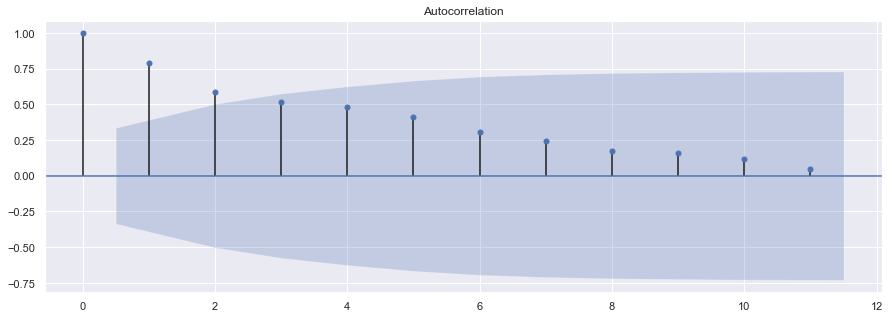

In [117]:
months = 12 # Cantidad de meses en 1 año.
years = 1 # Cantidad de años observados.

nlags= months*years           

# Plot Autorcorrelación
plt.rcParams['figure.figsize'] = [15,5]
plot_acf(st_M1['ing_total'], lags = np.arange(nlags))
plt.show()

##### Dos años

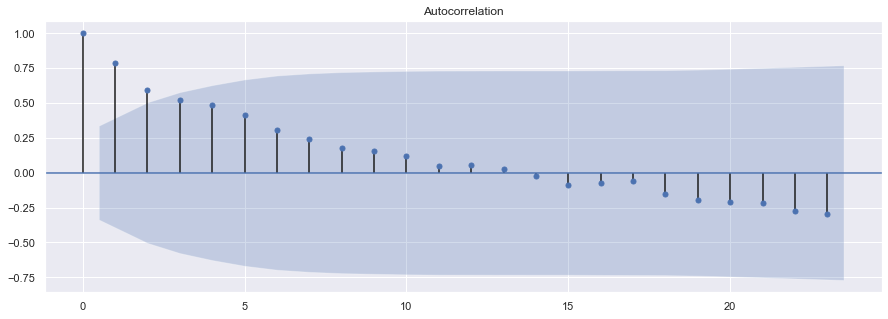

In [118]:
months = 12 # Cantidad de semanas en 1 año.
years = 2 # Cantidad de años observados.

nlags= months*years           

# Plot Autorcorrelación
plt.rcParams['figure.figsize'] = [15,5]
plot_acf(st_M1['ing_total'], lags = np.arange(nlags))
plt.show()

### Promedio mensual

In [119]:
st_M2 = pd.DataFrame()

st_M2['ing_total'] = ts['ingresos'].resample('M').mean()
st_M2['ing_zafran'] = ts['ing_zafran'].resample('M').mean()
st_M2['ing_zafranito'] = ts['ing_zafranito'].resample('M').mean()

st_M2['Year'] = st_M2.index.year
st_M2['Month'] = st_M2.index.month

# Fillnan
st_M2.fillna(0,inplace=True)
st_M2

,ing_total,ing_zafran,ing_zafranito,Year,Month
date,,,,,
2018-07-31,1690.05,1690.05,0.00,2018,7
2018-08-31,0.00,0.00,0.00,2018,8
2018-09-30,2455.15,2455.15,0.00,2018,9
2018-10-31,1888.83,1888.83,0.00,2018,10
2018-11-30,1715.04,1715.04,0.00,2018,11
2018-12-31,2766.08,2766.08,0.00,2018,12
2019-01-31,1587.83,1587.83,0.00,2019,1
2019-02-28,3008.10,3008.10,0.00,2019,2
2019-03-31,2038.11,2038.11,0.00,2019,3


### Acumulado anual

In [120]:
st_Y1 = pd.DataFrame()

st_Y1['ing_total'] = ts['ingresos'].resample('Y').sum()
st_Y1['ing_zafran'] = ts['ing_zafran'].resample('Y').sum()
st_Y1['ing_zafranito'] = ts['ing_zafranito'].resample('Y').sum()

st_Y1['Year'] = st_Y1.index.year

# Fillnan
st_Y1.fillna(0,inplace=True)
st_Y1

,ing_total,ing_zafran,ing_zafranito,Year
date,,,,
2018-12-31,12865216.43,12865216.43,0.00,2018
2019-12-31,57382239.99,57382239.99,0.00,2019
2020-12-31,89425287.05,84076559.69,5348727.36,2020
2021-12-31,46924808.46,45560837.46,1363971.00,2021


### Promedio anual

In [121]:
st_Y2 = pd.DataFrame()

st_Y2['ing_total'] = ts['ingresos'].resample('Y').mean()
st_Y2['ing_zafran'] = ts['ing_zafran'].resample('Y').mean()
st_Y2['ing_zafranito'] = ts['ing_zafranito'].resample('Y').mean()

st_Y2['Year'] = st_Y2.index.year

# Fillnan
st_Y2.fillna(0,inplace=True)
st_Y2

,ing_total,ing_zafran,ing_zafranito,Year
date,,,,
2018-12-31,2120.52,2120.52,0.00,2018
2019-12-31,2886.29,2886.29,0.00,2019
2020-12-31,5014.60,4714.66,299.93,2020
2021-12-31,7586.87,7366.34,220.53,2021


## Tendencia y Estacionalidad

La descomposición proporciona un modelo abstracto útil para **comprender** mejor los problemas durante el **análisis** y la **predicción** de series de tiempo.

Una **abstracción** útil para seleccionar métodos de pronóstico es dividir una serie de tiempo en **componentes**:
- **Sistemáticos**: Componentes de la serie temporal que tienen consistencia o recurrencia y pueden describirse y modelarse.
- **No sistemáticos**: componentes de la serie temporal que no se pueden modelar directamente.

Una serie de tiempo **consta de tres componentes sistemáticos** que incluyen **nivel, tendencia, estacionalidad y un** componente **no sistemático** llamado **ruido**.

Estos componentes se definen como:
- **Nivel**: el valor medio de la serie.
- **Tendencia**: el valor creciente o decreciente de la serie.
- **Estacionalidad**: el ciclo a corto plazo que se repite en la serie.
- **Ruido**: la variación aleatoria en la serie.

Un **modelo aditivo** sugiere que los componentes se sumen de la siguiente manera:
	
`y(t) = Level + Trend + Seasonality + Noise`

Un modelo aditivo es lineal en el que los cambios a lo largo del tiempo se realizan constantemente en la misma cantidad.

Una tendencia lineal es una línea recta.

Una estacionalidad lineal tiene la misma frecuencia (ancho de ciclos) y amplitud (altura de ciclos).


Un **modelo multiplicativo** sugiere que los componentes se multipliquen de la siguiente manera:

`y(t) = Level * Trend * Seasonality * Noise`

Un modelo multiplicativo no es lineal, como cuadrático o exponencial. Los cambios aumentan o disminuyen con el tiempo.

Una tendencia no lineal es una línea curva.

Una estacionalidad no lineal tiene una frecuencia y / o amplitud creciente o decreciente a lo largo del tiempo.

Los problemas del mundo real son complicados y ruidosos. Puede haber componentes aditivos y multiplicativos. Puede haber una tendencia creciente seguida de una tendencia decreciente. Puede haber ciclos no repetidos mezclados con los componentes de estacionalidad repetidos.


Es por ello que quizá se pueda pueda o no, catalogar la serie de tiempo como un modelo aditivo o multiplicativo.

Veamos qué sucede con nuestra serie. Para ello, utilizaremos la función season_decompose (). El objeto resultante contiene las matrices para acceder a los cuatro datos de la descomposición.

### Por día

In [122]:
decomp_diaria_A_add = tsa.seasonal.seasonal_decompose(
    st_D1.ing_total, model='additive', extrapolate_trend='freq'
)

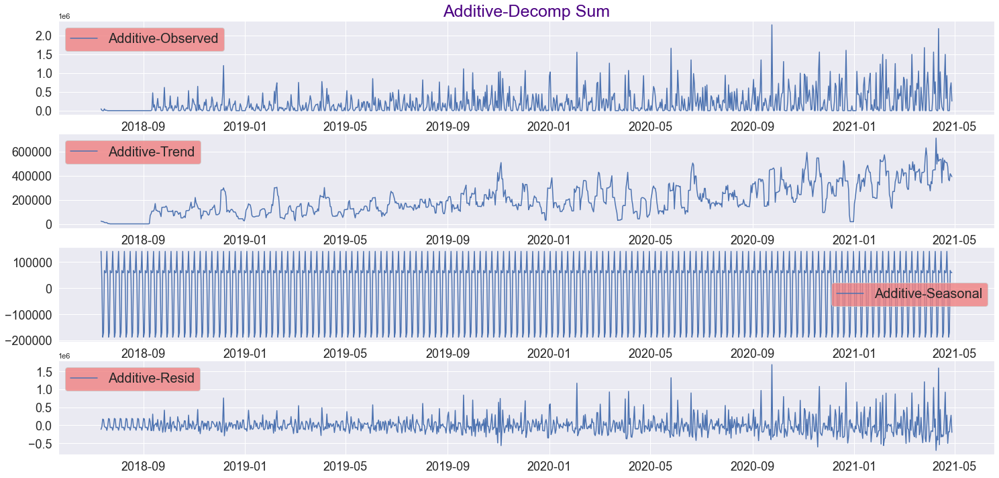

In [123]:
plt.figure(figsize=(25,15))

Gs= gs.GridSpec(5,1)
ax1= plt.subplot(Gs[0])
plt.title("Additive-Decomp Sum", fontsize=25, color= "indigo")
plt.plot(decomp_diaria_A_add.observed, label= "Additive-Observed")
plt.legend(fontsize=20, facecolor= 'lightcoral')
plt.xticks(fontsize= 18)
plt.yticks(fontsize= 18)

ax3= plt.subplot(Gs[1])
plt.plot(decomp_diaria_A_add.trend, label= "Additive-Trend")
plt.legend(fontsize=20, facecolor= 'lightcoral')
plt.xticks(fontsize= 18)
plt.yticks(fontsize= 18)

ax5= plt.subplot(Gs[2])
plt.plot(decomp_diaria_A_add.seasonal, label= "Additive-Seasonal")
plt.legend(fontsize=20, facecolor= 'lightcoral')
plt.xticks(fontsize= 18)
plt.yticks(fontsize= 18)

ax7= plt.subplot(Gs[3])
plt.plot(decomp_diaria_A_add.resid, label= "Additive-Resid")
plt.legend(fontsize=20, facecolor= 'lightcoral', loc= 2)
plt.xticks(fontsize= 18)
plt.yticks(fontsize= 18)


plt.show()

##### **Conclusión de la descomposición**

- El modelo es aditivo.
- En el primer gráfico se observa la serie en sí.
- El segundo gráfico devuelve la tendencia de la serie, la cual destacamos su positividad.
- El tercer gráfico representa la estacionalidad. Es decir, que se pueden apreciar las fluctuaciones internas que suceden por dentro de la serie.
- El grafico "Resid", devuelve el ruido de la serie. Al observar que los residuales, se encuentran sin correlacion alguna y el promedio en general se encuentra fijo en 0, nos lleva a pensar que el rudio de nuestra serie es "White Noise" y estamos ante una serie apta para su modelado.


Observemos si descomponiendo la serie en otras unidades de tiempo es más visual.

### Por semana

In [124]:
decomp_sem_A_add = tsa.seasonal.seasonal_decompose(
    st_W1.ing_total, model='additive', extrapolate_trend='freq'
)


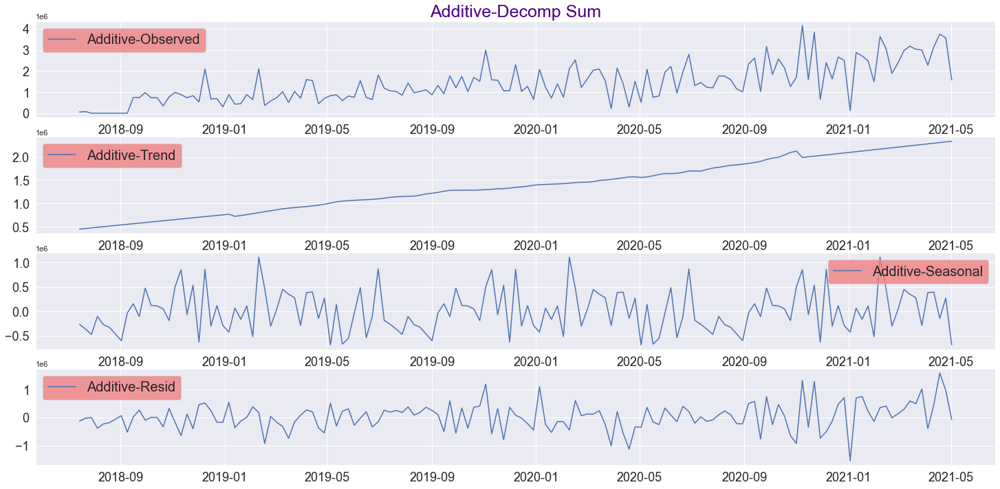

In [125]:
plt.figure(figsize=(25,15))

Gs= gs.GridSpec(5,1)
ax1= plt.subplot(Gs[0])
plt.title("Additive-Decomp Sum", fontsize=25, color= "indigo")
plt.plot(decomp_sem_A_add.observed, label= "Additive-Observed")
plt.legend(fontsize=20, facecolor= 'lightcoral')
plt.xticks(fontsize= 18)
plt.yticks(fontsize= 18)

ax3= plt.subplot(Gs[1])
plt.plot(decomp_sem_A_add.trend, label= "Additive-Trend")
plt.legend(fontsize=20, facecolor= 'lightcoral')
plt.xticks(fontsize= 18)
plt.yticks(fontsize= 18)

ax5= plt.subplot(Gs[2])
plt.plot(decomp_sem_A_add.seasonal, label= "Additive-Seasonal")
plt.legend(fontsize=20, facecolor= 'lightcoral')
plt.xticks(fontsize= 18)
plt.yticks(fontsize= 18)

ax7= plt.subplot(Gs[3])
plt.plot(decomp_sem_A_add.resid, label= "Additive-Resid")
plt.legend(fontsize=20, facecolor= 'lightcoral', loc= 2)
plt.xticks(fontsize= 18)
plt.yticks(fontsize= 18)


plt.show()

##### **Conclusión de la descomposición**

- La tendencia es claramente positiva.

- Se observa la estacionalidad un ciclo que se repite de septiembre a septiembre.

### Por mes

In [126]:
decomp_men_A_add = tsa.seasonal.seasonal_decompose(
    st_M1.ing_total, model='additive', extrapolate_trend='freq'
)

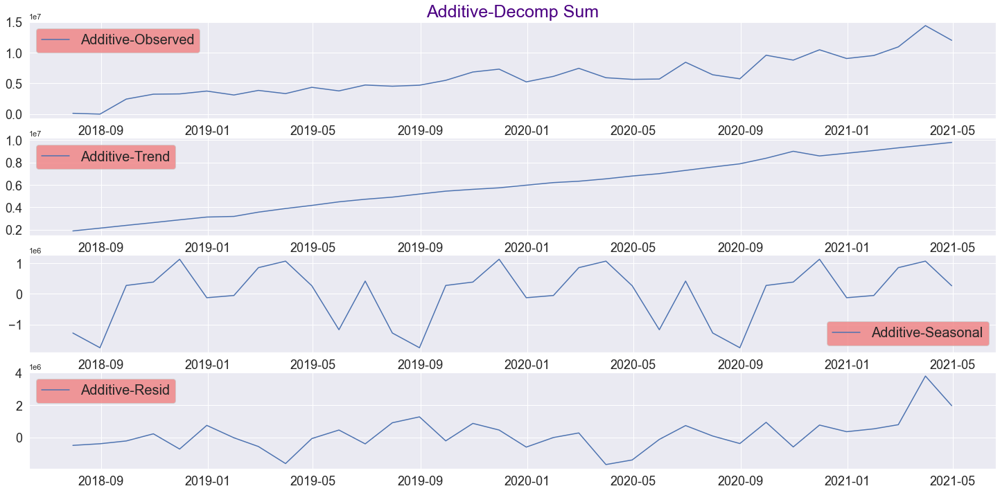

In [127]:
plt.figure(figsize=(25,15))

Gs= gs.GridSpec(5,1)
ax1= plt.subplot(Gs[0])
plt.title("Additive-Decomp Sum", fontsize=25, color= "indigo")
plt.plot(decomp_men_A_add.observed, label= "Additive-Observed")
plt.legend(fontsize=20, facecolor= 'lightcoral')
plt.xticks(fontsize= 18)
plt.yticks(fontsize= 18)

ax3= plt.subplot(Gs[1])
plt.plot(decomp_men_A_add.trend, label= "Additive-Trend")
plt.legend(fontsize=20, facecolor= 'lightcoral')
plt.xticks(fontsize= 18)
plt.yticks(fontsize= 18)

ax5= plt.subplot(Gs[2])
plt.plot(decomp_men_A_add.seasonal, label= "Additive-Seasonal")
plt.legend(fontsize=20, facecolor= 'lightcoral')
plt.xticks(fontsize= 18)
plt.yticks(fontsize= 18)

ax7= plt.subplot(Gs[3])
plt.plot(decomp_men_A_add.resid, label= "Additive-Resid")
plt.legend(fontsize=20, facecolor= 'lightcoral', loc= 2)
plt.xticks(fontsize= 18)
plt.yticks(fontsize= 18)


plt.show()

##### **Conclusión de la descomposición**

- Se intensifica la la tendencia positiva.

- Se intensifica la estacionalidad de septiembre a septiembre.

### Por año

In [128]:
decomp_anu_A_add = tsa.seasonal.seasonal_decompose(
    st_Y1.ing_total, model='additive', extrapolate_trend='freq'
)

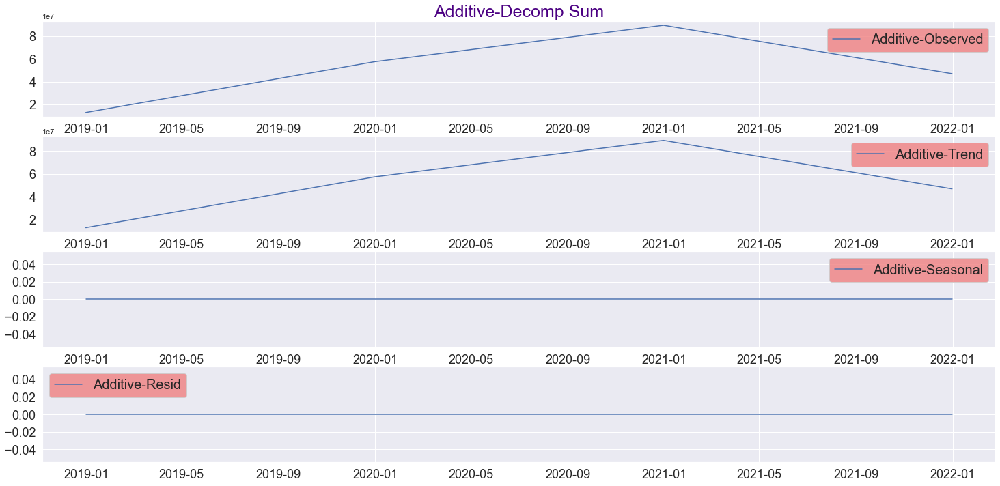

In [129]:
plt.figure(figsize=(25,15))

Gs= gs.GridSpec(5,1)
ax1= plt.subplot(Gs[0])
plt.title("Additive-Decomp Sum", fontsize=25, color= "indigo")
plt.plot(decomp_anu_A_add.observed, label= "Additive-Observed")
plt.legend(fontsize=20, facecolor= 'lightcoral')
plt.xticks(fontsize= 18)
plt.yticks(fontsize= 18)

ax3= plt.subplot(Gs[1])
plt.plot(decomp_anu_A_add.trend, label= "Additive-Trend")
plt.legend(fontsize=20, facecolor= 'lightcoral')
plt.xticks(fontsize= 18)
plt.yticks(fontsize= 18)

ax5= plt.subplot(Gs[2])
plt.plot(decomp_anu_A_add.seasonal, label= "Additive-Seasonal")
plt.legend(fontsize=20, facecolor= 'lightcoral')
plt.xticks(fontsize= 18)
plt.yticks(fontsize= 18)

ax7= plt.subplot(Gs[3])
plt.plot(decomp_anu_A_add.resid, label= "Additive-Resid")
plt.legend(fontsize=20, facecolor= 'lightcoral', loc= 2)
plt.xticks(fontsize= 18)
plt.yticks(fontsize= 18)


plt.show()

##### **Conclusión de la descomposición**

- Los años observados son muy pocos como para poder ilustrar la tendencia y la estacionalidad en esta unidad de tiempo

## Análisis de Tendencia y Estacionalidad en barras

### Genero dataset

In [130]:
ts = df.loc[:, [
    'date',
    'product_category',
    'ingresos',
    ]
]
ts

,date,product_category,ingresos
0,2018-07-12,BAR,1562.18
1,2018-07-12,BAR,781.09
2,2018-07-12,BAR,781.09
3,2018-07-12,BAR,781.09
4,2018-07-13,GAL,312.80
...,...,...,...
49961,2021-04-28,GALZafranito,0.00
49962,2021-04-28,GALZafranito,0.00
49963,2021-04-28,BAR,6678.57
49964,2021-04-28,BAR,6678.57


In [131]:
#Reordenamos el dataset por fecha
ts.sort_values('date', inplace = True)
ts.reset_index(drop=True, inplace = True)

ts

,date,product_category,ingresos
0,2018-07-12,BAR,1562.18
1,2018-07-12,GRA240,10530.00
2,2018-07-12,GRA240,5850.00
3,2018-07-12,GRA240,5850.00
4,2018-07-12,GAL,2775.00
...,...,...,...
49961,2021-04-28,GAL,929.24
49962,2021-04-28,GRA240,2716.32
49963,2021-04-28,BAR,3270.43
49964,2021-04-28,BAR,3339.28


In [132]:
# elimino nulos
ts.dropna(inplace=True)

missing_zero_values_table(ts)

,Zero Values,% of Zero Values,Missing Values,% of Missing Values,Total Missing Values,% Total Missing Values
ingresos,4549,9.10,0,0.00,4549,9.10


'Your selected dataframe has 3 columns and 49966 Rows.\nThere are 1 columns that have missing values.'

In [133]:
ts = ts.set_index('date')
ts

,product_category,ingresos
date,,
2018-07-12,BAR,1562.18
2018-07-12,GRA240,10530.00
2018-07-12,GRA240,5850.00
2018-07-12,GRA240,5850.00
2018-07-12,GAL,2775.00
...,...,...
2021-04-28,GAL,929.24
2021-04-28,GRA240,2716.32
2021-04-28,BAR,3270.43


In [134]:
print()

var = 'product_category'
v1 = explore_var(ts[var],var,limit=10)
display(v1)
print()


There are **8** different value in the **product_category** variable of the dataframe.

The list of the **8**  values:

,unique_values,counts
0,BAR,21582
1,GAL,9978
2,GALmini,4845
3,MIX,3915
4,GRA240,3490
5,GRAkg,3388
6,GALZafranito,1530
7,ING,1238


In [135]:
ts['ing_bar'] = np.where(ts['product_category'] == 'BAR', ts['ingresos'],0)
ts['ing_notbar'] = np.where(ts['product_category'] != 'BAR', ts['ingresos'],0)
ts

,product_category,ingresos,ing_bar,ing_notbar
date,,,,
2018-07-12,BAR,1562.18,1562.18,0.00
2018-07-12,GRA240,10530.00,0.00,10530.00
2018-07-12,GRA240,5850.00,0.00,5850.00
2018-07-12,GRA240,5850.00,0.00,5850.00
2018-07-12,GAL,2775.00,0.00,2775.00
...,...,...,...,...
2021-04-28,GAL,929.24,0.00,929.24
2021-04-28,GRA240,2716.32,0.00,2716.32
2021-04-28,BAR,3270.43,3270.43,0.00


In [136]:
# Reseteo index para graficar

ts_ = ts.reset_index()
ts_

,date,product_category,ingresos,ing_bar,ing_notbar
0,2018-07-12,BAR,1562.18,1562.18,0.00
1,2018-07-12,GRA240,10530.00,0.00,10530.00
2,2018-07-12,GRA240,5850.00,0.00,5850.00
3,2018-07-12,GRA240,5850.00,0.00,5850.00
4,2018-07-12,GAL,2775.00,0.00,2775.00
...,...,...,...,...,...
49961,2021-04-28,GAL,929.24,0.00,929.24
49962,2021-04-28,GRA240,2716.32,0.00,2716.32
49963,2021-04-28,BAR,3270.43,3270.43,0.00
49964,2021-04-28,BAR,3339.28,3339.28,0.00


In [137]:
# Plot 
fig_1 = go.Figure()

fig_1.add_trace(go.Scatter(x=ts_['date'], y=ts_['ingresos'],mode='lines',name='Total'))
fig_1.add_trace(go.Scatter(x=ts_['date'], y=ts_['ing_bar'],mode='lines',name='Bar'))
fig_1.add_trace(go.Scatter(x=ts_['date'], y=ts_['ing_notbar'],mode='lines',name='Not Bar'))

fig_1.update_xaxes(
    rangeslider_visible=True,
    rangeselector=dict(
        buttons=list([
            dict(count=1, label="1m", step="month", stepmode="backward"),
            dict(count=6, label="6m", step="month", stepmode="backward"),
            dict(count=1, label="YTD", step="year", stepmode="todate"),
            dict(count=1, label="1y", step="year", stepmode="backward"),
            dict(step="all")
        ])
    )
)
fig_1.update_layout(
    title="Ingresos por imputación - Zafrán",
    width=990,
    height=500,
)
fig_1.show()

### Remuestreo

#### Diario

In [138]:
# Resampleo los datos para agrupar por acumulado diario
st_D1 = pd.DataFrame()

st_D1['ing_total'] = ts['ingresos'].resample('D').sum()
st_D1['ing_bar'] = ts['ing_bar'].resample('D').sum()
st_D1['ing_notbar'] = ts['ing_notbar'].resample('D').sum()
st_D1['Year'] = st_D1.index.year
st_D1['Month'] = st_D1.index.month
st_D1['Day'] = st_D1.index.day
st_D1

,ing_total,ing_bar,ing_notbar,Year,Month,Day
date,,,,,,
2018-07-12,47142.43,4980.27,42162.16,2018,7,12
2018-07-13,8868.30,2316.83,6551.47,2018,7,13
2018-07-14,0.00,0.00,0.00,2018,7,14
2018-07-15,0.00,0.00,0.00,2018,7,15
2018-07-16,47238.44,33558.15,13680.29,2018,7,16
...,...,...,...,...,...,...
2021-04-24,0.00,0.00,0.00,2021,4,24
2021-04-25,0.00,0.00,0.00,2021,4,25
2021-04-26,580656.07,458899.42,121756.65,2021,4,26


In [139]:
# Reseteo index para graficar

st_D1_ = st_D1.reset_index()

# Plot 
fig_2 = go.Figure()

fig_2.add_trace(go.Scatter(x=st_D1_['date'], y=st_D1_['ing_total'],mode='lines',name='Acumulado T'))
fig_2.add_trace(go.Scatter(x=st_D1_['date'], y=st_D1_['ing_bar'],mode='lines',name='Bar'))
fig_2.add_trace(go.Scatter(x=st_D1_['date'], y=st_D1_['ing_notbar'],mode='lines',name='Not Bar'))

fig_2.update_xaxes(
    rangeslider_visible=True,
    rangeselector=dict(
        buttons=list([
            dict(count=1, label="1m", step="month", stepmode="backward"),
            dict(count=6, label="6m", step="month", stepmode="backward"),
            dict(count=1, label="YTD", step="year", stepmode="todate"),
            dict(count=1, label="1y", step="year", stepmode="backward"),
            dict(step="all")
        ])
    )
)
fig_2.update_layout(
    title="Ingresos Acumulados por día - Zafrán",
    width=990,
    height=600,
)
fig_2.show()

#### Semanal

In [140]:
# Resampleo los datos para agrupar por semana

st_W1 = pd.DataFrame()

st_W1['ing_total'] = ts['ingresos'].resample('W').sum()
st_W1['ing_bar'] = ts['ing_bar'].resample('W').sum()
st_W1['ing_notbar'] = ts['ing_notbar'].resample('W').sum()

st_W1['Year'] = st_W1.index.year
st_W1['Month'] = st_W1.index.month
st_W1['Day'] = st_W1.index.day
st_W1

,ing_total,ing_bar,ing_notbar,Year,Month,Day
date,,,,,,
2018-07-15,56010.73,7297.10,48713.63,2018,7,15
2018-07-22,74123.40,48605.59,25517.81,2018,7,22
2018-07-29,0.00,0.00,0.00,2018,7,29
2018-08-05,0.00,0.00,0.00,2018,8,5
2018-08-12,0.00,0.00,0.00,2018,8,12
...,...,...,...,...,...,...
2021-04-04,2266605.73,1325826.51,940779.22,2021,4,4
2021-04-11,3140290.19,1896663.00,1243627.19,2021,4,11
2021-04-18,3744450.28,2721795.84,1022654.44,2021,4,18


In [141]:
# Reseteo index para graficar

st_W1_ = st_W1.reset_index()

# Plot 
fig_2 = go.Figure()

fig_2.add_trace(go.Scatter(x=st_W1_['date'], y=st_W1_['ing_total'],mode='lines',name='Acumulado T'))
fig_2.add_trace(go.Scatter(x=st_W1_['date'], y=st_W1_['ing_bar'],mode='lines',name='Bar'))
fig_2.add_trace(go.Scatter(x=st_W1_['date'], y=st_W1_['ing_notbar'],mode='lines',name='Not Bar'))

fig_2.update_xaxes(
    rangeslider_visible=True,
    rangeselector=dict(
        buttons=list([
            dict(count=1, label="1m", step="month", stepmode="backward"),
            dict(count=6, label="6m", step="month", stepmode="backward"),
            dict(count=1, label="YTD", step="year", stepmode="todate"),
            dict(count=1, label="1y", step="year", stepmode="backward"),
            dict(step="all")
        ])
    )
)
fig_2.update_layout(
    title="Ingresos Acumulados por semana - Zafrán",
    width=990,
    height=600,
)
fig_2.show()

#### Mensual

In [142]:
st_M1 = pd.DataFrame()

st_M1['ing_total'] = ts['ingresos'].resample('M').sum()
st_M1['ing_bar'] = ts['ing_bar'].resample('M').sum()
st_M1['ing_notbar'] = ts['ing_notbar'].resample('M').sum()

st_M1['Year'] = st_M1.index.year
st_M1['Month'] = st_M1.index.month

st_M1

,ing_total,ing_bar,ing_notbar,Year,Month
date,,,,,
2018-07-31,130134.13,55902.69,74231.44,2018,7
2018-08-31,0.00,0.00,0.00,2018,8
2018-09-30,2445328.77,1377479.23,1067849.54,2018,9
2018-10-31,3245016.81,1931916.58,1313100.23,2018,10
2018-11-30,3291168.18,1989728.95,1301439.23,2018,11
2018-12-31,3753568.54,1804315.26,1949253.28,2018,12
2019-01-31,3115325.20,1747594.94,1367730.26,2019,1
2019-02-28,3859391.21,1646374.81,2213016.40,2019,2
2019-03-31,3340458.69,1885898.02,1454560.67,2019,3


In [143]:
# Reseteo index para graficar

st_M1_ = st_M1.reset_index()

# Plot 
fig_3 = go.Figure()

fig_3.add_trace(go.Scatter(x=st_M1_['date'], y=st_M1_['ing_total'],mode='lines',name='Acumulado T'))
fig_3.add_trace(go.Scatter(x=st_M1_['date'], y=st_M1_['ing_bar'],mode='lines',name='Bar'))
fig_3.add_trace(go.Scatter(x=st_M1_['date'], y=st_M1_['ing_notbar'],mode='lines',name='Not Bar'))

fig_3.update_xaxes(
    rangeslider_visible=True,
    rangeselector=dict(
        buttons=list([
            dict(count=1, label="1m", step="month", stepmode="backward"),
            dict(count=6, label="6m", step="month", stepmode="backward"),
            dict(count=1, label="YTD", step="year", stepmode="todate"),
            dict(count=1, label="1y", step="year", stepmode="backward"),
            dict(step="all")
        ])
    )
)
fig_3.update_layout(
    title="Ingresos Acumulados por mes - Zafrán",
    width=990,
    height=600,
)
fig_3.show()

### Tendencia y Estacionalidad

#### Diaria

In [144]:
decomp_diaria_A_add = tsa.seasonal.seasonal_decompose(
    st_D1.ing_total, model='additive', extrapolate_trend='freq'
)

decomp_diaria_A_add_bar = tsa.seasonal.seasonal_decompose(
    st_D1.ing_bar, model='additive', extrapolate_trend='freq'
)

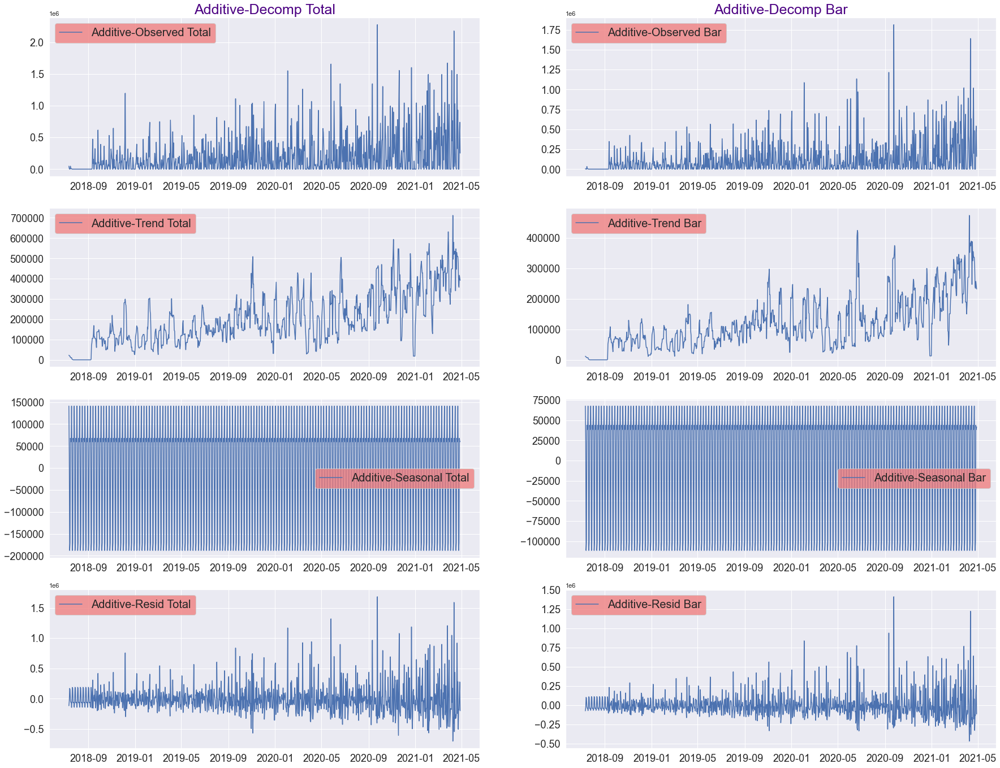

In [145]:
plt.figure(figsize=(30,30))

Gs= gs.GridSpec(5,2)

ax0= plt.subplot(Gs[0])
plt.title("Additive-Decomp Total", fontsize=25, color= "indigo")
plt.plot(decomp_diaria_A_add.observed, label= "Additive-Observed Total")
plt.legend(fontsize=20, facecolor= 'lightcoral')
plt.xticks(fontsize= 18)
plt.yticks(fontsize= 18)

ax1= plt.subplot(Gs[1])
plt.title("Additive-Decomp Bar", fontsize=25, color= "indigo")
plt.plot(decomp_diaria_A_add_bar.observed, label= "Additive-Observed Bar")
plt.legend(fontsize=20, facecolor= 'lightcoral')
plt.xticks(fontsize= 18)
plt.yticks(fontsize= 18)

ax2= plt.subplot(Gs[2])
plt.plot(decomp_diaria_A_add.trend, label= "Additive-Trend Total")
plt.legend(fontsize=20, facecolor= 'lightcoral')
plt.xticks(fontsize= 18)
plt.yticks(fontsize= 18)

ax3= plt.subplot(Gs[3])
plt.plot(decomp_diaria_A_add_bar.trend, label= "Additive-Trend Bar")
plt.legend(fontsize=20, facecolor= 'lightcoral')
plt.xticks(fontsize= 18)
plt.yticks(fontsize= 18)

ax4= plt.subplot(Gs[4])
plt.plot(decomp_diaria_A_add.seasonal, label= "Additive-Seasonal Total")
plt.legend(fontsize=20, facecolor= 'lightcoral')
plt.xticks(fontsize= 18)
plt.yticks(fontsize= 18)

ax5= plt.subplot(Gs[5])
plt.plot(decomp_diaria_A_add_bar.seasonal, label= "Additive-Seasonal Bar")
plt.legend(fontsize=20, facecolor= 'lightcoral')
plt.xticks(fontsize= 18)
plt.yticks(fontsize= 18)

ax6= plt.subplot(Gs[6])
plt.plot(decomp_diaria_A_add.resid, label= "Additive-Resid Total")
plt.legend(fontsize=20, facecolor= 'lightcoral')
plt.xticks(fontsize= 18)
plt.yticks(fontsize= 18)

ax7= plt.subplot(Gs[7])
plt.plot(decomp_diaria_A_add_bar.resid, label= "Additive-Resid Bar")
plt.legend(fontsize=20, facecolor= 'lightcoral', loc= 2)
plt.xticks(fontsize= 18)
plt.yticks(fontsize= 18)


plt.show()

##### **Descomposición Total vs BAR**

- Ambas son aditivas. El comportamiento es similar.

- La tendencia es positiva.
- La estacionalidad presenta fluctuaciones.

Observemos si descomponiendo la serie en otras unidades de tiempo es más visual.

In [146]:
# Guardo el resultado

decomp = pd.DataFrame()
decomp['observed'] = decomp_diaria_A_add_bar.observed
decomp['trend'] = decomp_diaria_A_add_bar.trend
decomp['seasonal'] = decomp_diaria_A_add_bar.seasonal
decomp['resid'] = decomp_diaria_A_add_bar.resid

decomp.to_csv(output_folder+'decomp_diaria_A_add_bar.csv')

decomp

,observed,trend,seasonal,resid
date,,,,
2018-07-12,4980.27,11740.51,67658.83,-74419.07
2018-07-13,2316.83,10716.20,20801.18,-29200.55
2018-07-14,0.00,9691.89,-111542.93,101851.04
2018-07-15,0.00,7525.46,-100977.27,93451.80
2018-07-16,33558.15,7274.63,43850.41,-17566.89
...,...,...,...,...
2021-04-24,0.00,240211.09,-111542.93,-128668.16
2021-04-25,0.00,234700.46,-100977.27,-133723.19
2021-04-26,458899.42,257287.43,43850.41,157761.58


#### Semanal

In [147]:
decomp_sem_A_add = tsa.seasonal.seasonal_decompose(
    st_W1.ing_total, model='additive', extrapolate_trend='freq'
)

decomp_sem_A_add_bar = tsa.seasonal.seasonal_decompose(
    st_W1.ing_bar, model='additive', extrapolate_trend='freq'
)

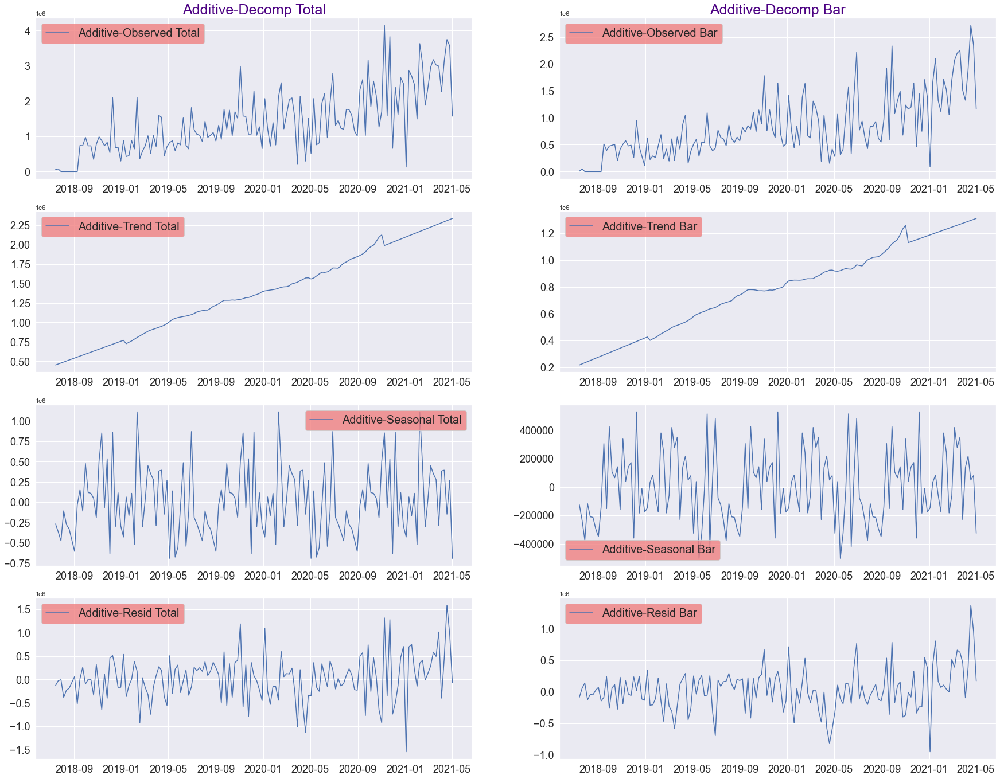

In [148]:
plt.figure(figsize=(30,30))

Gs= gs.GridSpec(5,2)

ax0= plt.subplot(Gs[0])
plt.title("Additive-Decomp Total", fontsize=25, color= "indigo")
plt.plot(decomp_sem_A_add.observed, label= "Additive-Observed Total")
plt.legend(fontsize=20, facecolor= 'lightcoral')
plt.xticks(fontsize= 18)
plt.yticks(fontsize= 18)

ax1= plt.subplot(Gs[1])
plt.title("Additive-Decomp Bar", fontsize=25, color= "indigo")
plt.plot(decomp_sem_A_add_bar.observed, label= "Additive-Observed Bar")
plt.legend(fontsize=20, facecolor= 'lightcoral')
plt.xticks(fontsize= 18)
plt.yticks(fontsize= 18)

ax2= plt.subplot(Gs[2])
plt.plot(decomp_sem_A_add.trend, label= "Additive-Trend Total")
plt.legend(fontsize=20, facecolor= 'lightcoral')
plt.xticks(fontsize= 18)
plt.yticks(fontsize= 18)

ax3= plt.subplot(Gs[3])
plt.plot(decomp_sem_A_add_bar.trend, label= "Additive-Trend Bar")
plt.legend(fontsize=20, facecolor= 'lightcoral')
plt.xticks(fontsize= 18)
plt.yticks(fontsize= 18)

ax4= plt.subplot(Gs[4])
plt.plot(decomp_sem_A_add.seasonal, label= "Additive-Seasonal Total")
plt.legend(fontsize=20, facecolor= 'lightcoral')
plt.xticks(fontsize= 18)
plt.yticks(fontsize= 18)

ax5= plt.subplot(Gs[5])
plt.plot(decomp_sem_A_add_bar.seasonal, label= "Additive-Seasonal Bar")
plt.legend(fontsize=20, facecolor= 'lightcoral')
plt.xticks(fontsize= 18)
plt.yticks(fontsize= 18)

ax6= plt.subplot(Gs[6])
plt.plot(decomp_sem_A_add.resid, label= "Additive-Resid Total")
plt.legend(fontsize=20, facecolor= 'lightcoral')
plt.xticks(fontsize= 18)
plt.yticks(fontsize= 18)

ax7= plt.subplot(Gs[7])
plt.plot(decomp_sem_A_add_bar.resid, label= "Additive-Resid Bar")
plt.legend(fontsize=20, facecolor= 'lightcoral', loc= 2)
plt.xticks(fontsize= 18)
plt.yticks(fontsize= 18)


plt.show()

##### **Descomposición Total vs BAR**

- El comportamiento es similar.

- La tendencia es positiva.
- La estacionalidad existe y es muy clara.


In [149]:
# Guardo el resultado

decomp = pd.DataFrame()
decomp['observed'] = decomp_sem_A_add_bar.observed
decomp['trend'] = decomp_sem_A_add_bar.trend
decomp['seasonal'] = decomp_sem_A_add_bar.seasonal
decomp['resid'] = decomp_sem_A_add_bar.resid

decomp.to_csv(output_folder+'decomp_sem_A_add_bar.csv')

decomp

,observed,trend,seasonal,resid
date,,,,
2018-07-15,7297.10,217209.46,-125698.59,-84213.77
2018-07-22,48605.59,225569.15,-234690.55,57726.99
2018-07-29,0.00,233928.85,-375632.46,141703.61
2018-08-05,0.00,242288.54,-117352.69,-124935.85
2018-08-12,0.00,250648.23,-210058.80,-40589.44
...,...,...,...,...
2021-04-04,1325826.51,1282748.52,137023.41,-93945.42
2021-04-11,1896663.00,1289986.14,217511.64,389165.22
2021-04-18,2721795.84,1297223.75,48852.66,1375719.43


#### Mensual

In [150]:
decomp_men_A_add = tsa.seasonal.seasonal_decompose(
    st_W1.ing_total, model='additive', extrapolate_trend='freq'
)

decomp_men_A_add_bar = tsa.seasonal.seasonal_decompose(
    st_W1.ing_bar, model='additive', extrapolate_trend='freq'
)

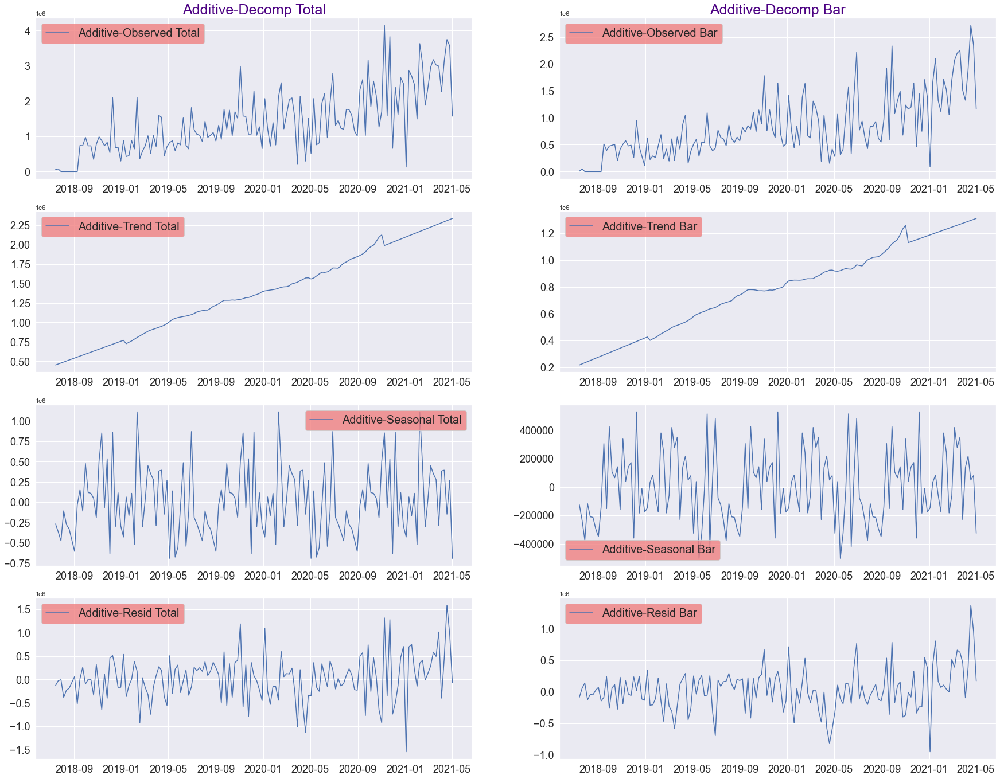

In [151]:
plt.figure(figsize=(30,30))

Gs= gs.GridSpec(5,2)

ax0= plt.subplot(Gs[0])
plt.title("Additive-Decomp Total", fontsize=25, color= "indigo")
plt.plot(decomp_men_A_add.observed, label= "Additive-Observed Total")
plt.legend(fontsize=20, facecolor= 'lightcoral')
plt.xticks(fontsize= 18)
plt.yticks(fontsize= 18)

ax1= plt.subplot(Gs[1])
plt.title("Additive-Decomp Bar", fontsize=25, color= "indigo")
plt.plot(decomp_men_A_add_bar.observed, label= "Additive-Observed Bar")
plt.legend(fontsize=20, facecolor= 'lightcoral')
plt.xticks(fontsize= 18)
plt.yticks(fontsize= 18)

ax2= plt.subplot(Gs[2])
plt.plot(decomp_men_A_add.trend, label= "Additive-Trend Total")
plt.legend(fontsize=20, facecolor= 'lightcoral')
plt.xticks(fontsize= 18)
plt.yticks(fontsize= 18)

ax3= plt.subplot(Gs[3])
plt.plot(decomp_men_A_add_bar.trend, label= "Additive-Trend Bar")
plt.legend(fontsize=20, facecolor= 'lightcoral')
plt.xticks(fontsize= 18)
plt.yticks(fontsize= 18)

ax4= plt.subplot(Gs[4])
plt.plot(decomp_men_A_add.seasonal, label= "Additive-Seasonal Total")
plt.legend(fontsize=20, facecolor= 'lightcoral')
plt.xticks(fontsize= 18)
plt.yticks(fontsize= 18)

ax5= plt.subplot(Gs[5])
plt.plot(decomp_men_A_add_bar.seasonal, label= "Additive-Seasonal Bar")
plt.legend(fontsize=20, facecolor= 'lightcoral')
plt.xticks(fontsize= 18)
plt.yticks(fontsize= 18)

ax6= plt.subplot(Gs[6])
plt.plot(decomp_men_A_add.resid, label= "Additive-Resid Total")
plt.legend(fontsize=20, facecolor= 'lightcoral')
plt.xticks(fontsize= 18)
plt.yticks(fontsize= 18)

ax7= plt.subplot(Gs[7])
plt.plot(decomp_men_A_add_bar.resid, label= "Additive-Resid Bar")
plt.legend(fontsize=20, facecolor= 'lightcoral', loc= 2)
plt.xticks(fontsize= 18)
plt.yticks(fontsize= 18)


plt.show()

##### **Descomposición Total vs BAR**

- El comportamiento es similar.

- La tendencia es positiva.
- La estacionalidad existe y es muy clara.


In [152]:
# Guardo el resultado

decomp = pd.DataFrame()
decomp['observed'] = decomp_men_A_add_bar.observed
decomp['trend'] = decomp_men_A_add_bar.trend
decomp['seasonal'] = decomp_men_A_add_bar.seasonal
decomp['resid'] = decomp_men_A_add_bar.resid

decomp.to_csv(output_folder+'decomp_men_A_add_bar.csv')

decomp

,observed,trend,seasonal,resid
date,,,,
2018-07-15,7297.10,217209.46,-125698.59,-84213.77
2018-07-22,48605.59,225569.15,-234690.55,57726.99
2018-07-29,0.00,233928.85,-375632.46,141703.61
2018-08-05,0.00,242288.54,-117352.69,-124935.85
2018-08-12,0.00,250648.23,-210058.80,-40589.44
...,...,...,...,...
2021-04-04,1325826.51,1282748.52,137023.41,-93945.42
2021-04-11,1896663.00,1289986.14,217511.64,389165.22
2021-04-18,2721795.84,1297223.75,48852.66,1375719.43
